# Investigating the Blog Authorship Corpus using readability tests
## Data Caveats
We are using the [Blog Authorship corpus](https://u.cs.biu.ac.il/~koppel/BlogCorpus.htm) [1]. This data consists blog entries accompanied by author metadata, and is used for authorship verification tasks and other general NLP research. Unfortunately this corpus suffers from several design issues that affect its use. Some of these will be highlighted in a discovery-oriented manner below. Key issues include:

1. Blog collection shows sampling bias towards those who want to show off their writing publicly, which means it is probably not representative of the general population (i.e. you would get very different results from forcing a representative sample of people to write). However, we might argue that most written text is aflicted with the same bias, so it might still be representative of the body of all English written text from its time period.
2. The corpus claims to be drawn from blogs on blogger.com whose posts include 200 or more English words (in order to limit the corpus to English text). Unfortunately that appears to mean that any blog that happened to, in the entirety of all its entries, include at least 200 English words, was included. This means there are non-English blogs and multi-lingual entries included.
3. The dates provided in the metadata are in the form `[day number] [month name in region] [year in 4 digits]`. This means that there are 12 different languages of month names in use, so date parsing is not easy.
4. The metadata's date range extends beyond the date on which the data was allegedly collected, making the dates suspect. In particular a single extremely late outlier exists.
5. All metadata is user-provided, and therefore not individually reliable. 
6. The "age" column is self reported and the sampling method leaves large gaps in age distribution. The data authors chose to collect blogs from authors whose ages lay in the intervals (13, 17), (23, 27), (33, 47). The number of blogs in each age range is different, and the method for getting these numbers is not known.
7. The "gender" column (intended to mean sex) is self-reported and restricted to male/female. Equal numbers of males and females were selected for each age interval, though the number of *blog posts* was not controlled. The original relationship between sex, age, and number of bloggers is not preserved.
8. The "topic" column is mislabeled: it actually is the self-reported vocational identification, roughly corresponding to the industry in which the blogger works, not the subject of their writing. Some of these industries are heavily sex-biased in reality, and this is reflected in the data sample but not necessarily in a useful proportionate way.
9. Duplicate entries exist.

## Computational environment
This notebook was created on an Amazon EC2 m5d.4xlarge machine, with 16 virtual CPUs and 64 GiB of RAM. The environment was Amazon's Deep Learning AMI (Ubuntu 18.04.5 LTS) Version 26.0. Theoretically any comparable system should be able to reproduce the same results, though lower memory systems may take longer or experience errors.

## Environment prep and imports

In [1]:
%pylab inline

Populating the interactive namespace from numpy and matplotlib


In [2]:
import matplotlib.colors as colors

In [3]:
import pandas as pd
from tqdm.notebook import tqdm
import string
import pickle

In [4]:
from readability import Readability
import nltk
import plotly.express as px
import plotly.graph_objects as go

In [5]:
from urlextract import URLExtract
extractor = URLExtract()

In [6]:
features = [
    "vocab_quotient",
    "num_urls",
    "urls_per_word",
    "dale_chall_dificult_words_per_word",
    "gunning_complex_per_word",
    "spache_complex_per_word",
    "poly_syllable_per_word",
    "num_words",
    "num_letters",
    "num_sentences",
    "syllables_per_word",
    "words_per_sentence",
    "sentences_per_word",
    "letters_per_word",
]

demographics = [
    "gender_id",
    "age",
]

demographics_names = [
    "Sex",
    "Age",
]

score_functions = [
    "vocab_quotient",
    "dale_chall", 
    "ari", 
    "coleman_liau", 
    "spache", 
    "linsear_write", 
    "flesch", 
    "flesch-kincaid",
]

readability_functions = [
    "dale_chall", 
    "ari", 
    "coleman_liau", 
    "spache", 
    "linsear_write", 
    "flesch", 
    "flesch-kincaid",
]

readability_names = [
    "Dale-Chall",
    "ARI",
    "Coleman-Liau",
    "Spache",
    "Linsear Write",
    "Flesch",
    "Flesch-Kincaid",
]

In [7]:
nltk.download('punkt')

[nltk_data] Downloading package punkt to /home/ubuntu/nltk_data...
[nltk_data]   Package punkt is already up-to-date!


True

In [8]:
import fasttext

We are going to use a FastText language ID model because it is... fast. 

## Language classification, data parsing, etc.

Don't run these cells if you already have the models and dataframes they produce, they take a long time.

In [13]:
! wget https://dl.fbaipublicfiles.com/fasttext/supervised-models/lid.176.bin

--2021-09-27 20:33:15--  https://dl.fbaipublicfiles.com/fasttext/supervised-models/lid.176.bin
Resolving dl.fbaipublicfiles.com (dl.fbaipublicfiles.com)... 104.22.75.142, 104.22.74.142, 172.67.9.4, ...
Connecting to dl.fbaipublicfiles.com (dl.fbaipublicfiles.com)|104.22.75.142|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 131266198 (125M) [application/octet-stream]
Saving to: ‘lid.176.bin’

lid.176.bin         100%[===================>] 125.18M  20.2MB/s    in 6.9s    

2021-09-27 20:33:22 (18.3 MB/s) - ‘lid.176.bin’ saved [131266198/131266198]



In [14]:
! mv lid.176.bin ../Models/

In [15]:
path_to_pretrained_model = '../Models/lid.176.bin'
fmodel = fasttext.load_model(path_to_pretrained_model)

In [16]:
fmodel.predict(["como se llama?", "Hi, my name is Howard"])

([['__label__es'], ['__label__en']],
 [array([0.9905941], dtype=float32), array([0.87743247], dtype=float32)])

In [17]:
def get_lang(text_string, fmodel=fmodel):
    """Wrap the fasttext prediction for a single text_string to provide only the language code.
    """
# # You can make this function more versatile but slower by uncommenting this    
#     if type(text_string)==list:        
#         return [i[0].split("__")[2] for i in fmodel.predict(text_string)[0]]
#     else:
    return fmodel.predict(text_string)[0][0].split("__")[2]

In [18]:
get_lang("a single test")

'en'

### Data prep and read-in
The pickle we are reading in below was output by the `blog_data_prep.ipynb` notebook. It is basically just a dataframe of the original CSV data from Kaggle, but with a column of word tokens included. Tokenization was done with the NLTK casual strategy, since this is suited to social media text.

In [19]:
with open("../Data/blog_df_casual_tokens.pkl", "rb") as pfile:
    kdf = pickle.load(pfile)

In [20]:
kdf.shape

(681284, 8)

The original paper introducing this corpus [1] said each "blog" included in the corpus contained 200 or more English words. Unfortunately this seems to indicate that they chose authors that have written 200 or more words that match English dictionary words, NOT that each blog post was 200 words long or even in English. As a result, several languages are included in the corpus, and some blog posts mix languages. For our purposes we want to filter out all but the English posts. We are using a FastText language ID model because it is so speedy, but we won't use the confidence levels output. This means that we'll probably drop some texts that are English, but they will likely be the ones that are short and/or filled with weird tokens.

In [21]:
kdf["lang"] = kdf["text"].apply(get_lang)

In [22]:
kdf["lang"].value_counts()

en     672757
de       1095
tl        934
es        922
ja        857
        ...  
my          1
pa          1
kw          1
tt          1
jbo         1
Name: lang, Length: 102, dtype: int64

Here's some examples of the non-English content.

In [23]:
kdf[kdf["lang"]!="en"]

,id,gender,age,topic,sign,date,text,tokens,lang
232,3429420,male,15,Student,Aquarius,"05,June,2004",Warmth||||||||||||||||||58% Intellect||...,"[warmth, 58, intellect, 70, emotional, stabili...",pt
240,3429420,male,15,Student,Aquarius,"16,July,2004",'Wounded&nbsp; soul' &nbsp;,"[woundednbsp, soul, nbsp]",ru
347,649790,female,24,indUnk,Scorpio,"13,October,2002",Announcement!! NEW SHPIEL ...,"[announcement, new, shpiel, new, shpiel, new, ...",de
437,649790,female,24,indUnk,Scorpio,"08,October,2003",NEW SHPIEL!!!,"[new, shpiel]",de
1248,2559416,female,15,Student,Aquarius,"08,April,2004",Y depronto despertó… Al parecer h...,"[y, depronto, despertó, …, al, parecer, había,...",es
...,...,...,...,...,...,...,...,...,...
681059,3661649,female,13,Student,Pisces,"21,July,2004",urlLink 'OMG!!.. HaiXx!!....,"[urllink, omg, haixx, hahaznbsp, urllink]",fi
681085,3661649,female,13,Student,Pisces,"16,July,2004",urlLink KuAci~ BeN~ & Ah ...,"[urllink, kuaci, ben, ah, kin, hahaznbsp, urll...",ru
681116,3661649,female,13,Student,Pisces,"14,July,2004",urlLink ChRiStIne~~ hahaz...,"[urllink, christine, hahaz, number, 7, 7, nbsp...",ru
681134,3661649,female,13,Student,Pisces,"01,August,2004",urlLink Mý Dá®líng... Sh...,"[urllink, mý, dá, ®, líng, , shýáng, lí, ánd,...",pt


Egregious examples include the following.

In [24]:
kdf[kdf["lang"]=="ar"].loc[466954].text

'        عيونك شايفها وحاسس اني انا عارفها'

In [25]:
kdf[kdf["lang"]=="ja"].loc[678210].text

'             治ףõεĻƱסԤˡӦõģ˵ҵдˣҪ\u07b8ġǽ컹Ǹңphoto IDûˣҿҲûҸģ˷һʱ䡣 ȡƱȥ߶ˣıֻܶúܺãֻҪ\ue8ecĥѽ\u05fc֮ǰٶ\U000bce34κˣعûˣ         '

We will drop rows with fewer than $n$ tokens. If we do this before selecting the English-only posts, that step takes less work.

In [26]:
n=400 # minimum number of tokens required for a blog to be used

In [27]:
edf = kdf[kdf.tokens.apply(len)>=n].copy(deep=True)
edf.shape

(90196, 9)

In [28]:
edf.shape

(90196, 9)

In [29]:
lkdf = edf[edf["lang"] == 'en'].copy(deep=True)

In [30]:
lkdf.shape

(89795, 9)

In [31]:
with open("../Data/b_400_df.pkl", "wb") as outfile:
    pickle.dump(lkdf, outfile)

In [32]:
lkdf

,id,gender,age,topic,sign,date,text,tokens,lang
2,2059027,male,15,Student,Leo,"12,May,2004",In het kader van kernfusie op aarde...,"[in, het, kader, van, kernfusie, op, aarde, ma...",en
5,3581210,male,33,InvestmentBanking,Aquarius,"10,June,2004",I had an interesting conversation...,"[i, had, an, interesting, conversation, with, ...",en
11,3581210,male,33,InvestmentBanking,Aquarius,"09,June,2004",If you click on my profile you'll...,"[if, you, click, on, my, profile, youll, make,...",en
12,3581210,male,33,InvestmentBanking,Aquarius,"09,June,2004",Last night was pretty fun...mostl...,"[last, night, was, pretty, funmostly, because,...",en
18,3581210,male,33,InvestmentBanking,Aquarius,"17,June,2004","Well, I stand corrected, again. ...","[well, i, stand, corrected, again, yesterday, ...",en
...,...,...,...,...,...,...,...,...,...
681025,3661649,female,13,Student,Pisces,"31,July,2004",Message: 100 Days... Me...,"[message, 100, days, message, a, love, story, ...",en
681128,3661649,female,13,Student,Pisces,"08,August,2004","From the very beginning, th...","[from, the, very, beginning, the, girls, famil...",en
681156,4260903,female,34,indUnk,Virgo,"23,August,2004",I ran around cleaning all mor...,"[i, ran, around, cleaning, all, morning, becau...",en
681160,4260903,female,34,indUnk,Virgo,"18,August,2004",I want to consider myself a r...,"[i, want, to, consider, myself, a, rawfoodist,...",en


In [33]:
1-89795/681284

0.8681974037259058

Note that we have dropped 87% of the blog posts in the corpus at this point!

### Adding features

One extremely simple and language agnostic stylistic measure that is related to authorship attribution and readability is vocabulary entropy. We will use the normalized measure, called the vocabulary quotient, and only apply it to the last $k$ characters of each document for consistency.

In [34]:
def vocabulary_quotient(token_array, n=100):
    '''Compute the vocabulary quotient given a token array. 
    
    Use the last n tokens.
    '''
    if type(token_array)==list:
        token_array = array(token_array)
    token_array = token_array[-1*n:]
    doc_length = len(token_array)
    emp_probs =  {i:count_nonzero(token_array==i)/doc_length for i in list(set(token_array))}
    entropy = -sum([p_i * log10(p_i) for p_i in emp_probs.values()])
    max_entropy = -log10(1/doc_length)
    return(entropy/max_entropy)

In [35]:
vocabulary_quotient(lkdf[lkdf["id"]==2059027].tokens.item(), n=n)

0.8482780337467964

In [36]:
lkdf["vocab_quotient"] = lkdf.tokens.apply(vocabulary_quotient)

In [37]:
lkdf

,id,gender,age,topic,sign,date,text,tokens,lang,vocab_quotient
2,2059027,male,15,Student,Leo,"12,May,2004",In het kader van kernfusie op aarde...,"[in, het, kader, van, kernfusie, op, aarde, ma...",en,0.942406
5,3581210,male,33,InvestmentBanking,Aquarius,"10,June,2004",I had an interesting conversation...,"[i, had, an, interesting, conversation, with, ...",en,0.907020
11,3581210,male,33,InvestmentBanking,Aquarius,"09,June,2004",If you click on my profile you'll...,"[if, you, click, on, my, profile, youll, make,...",en,0.905486
12,3581210,male,33,InvestmentBanking,Aquarius,"09,June,2004",Last night was pretty fun...mostl...,"[last, night, was, pretty, funmostly, because,...",en,0.939396
18,3581210,male,33,InvestmentBanking,Aquarius,"17,June,2004","Well, I stand corrected, again. ...","[well, i, stand, corrected, again, yesterday, ...",en,0.904534
...,...,...,...,...,...,...,...,...,...,...
681025,3661649,female,13,Student,Pisces,"31,July,2004",Message: 100 Days... Me...,"[message, 100, days, message, a, love, story, ...",en,0.859880
681128,3661649,female,13,Student,Pisces,"08,August,2004","From the very beginning, th...","[from, the, very, beginning, the, girls, famil...",en,0.878641
681156,4260903,female,34,indUnk,Virgo,"23,August,2004",I ran around cleaning all mor...,"[i, ran, around, cleaning, all, morning, becau...",en,0.912890
681160,4260903,female,34,indUnk,Virgo,"18,August,2004",I want to consider myself a r...,"[i, want, to, consider, myself, a, rawfoodist,...",en,0.945416


All other scoring functions will be computed using [py-readability-metrics](https://py-readability-metrics.readthedocs.io/en/latest/) for convenience. The Readability module is not well-suited to Pandas `apply`, so we will run it through in a big loop and keep track of all the features and readability formula values of interest.

In [38]:
# features
dcc_per_word = []
gc_per_word = []
sc_per_word = []
psw_per_word = []
nwords = []
nletters = []
nsentences = []
syllables_per_word = []
words_per_sentence = []
# score functions
d = []
a = []
c = []
s = []
l = []
f = []
fk = []

for t in tqdm(lkdf.text):
    r = Readability(t)
    d.append(r.dale_chall().score)
    a.append(r.ari().score)
    c.append(r.coleman_liau().score)
    s.append(r.spache().score)
    l.append(r.linsear_write().score)
    f.append(r.flesch().score)
    fk.append(r.flesch_kincaid().score)
    dcc_per_word.append(r._statistics.num_dale_chall_complex/r._statistics.num_words)
    gc_per_word.append(r._statistics.num_gunning_complex/r._statistics.num_words)
    sc_per_word.append(r._statistics.num_spache_complex/r._statistics.num_words)
    psw_per_word.append(r._statistics.num_poly_syllable_words/r._statistics.num_words)
    nwords.append(r._statistics.num_words)
    nletters.append(r._statistics.num_letters)
    nsentences.append(r._statistics.num_sentences)
    syllables_per_word.append(r._statistics.avg_syllables_per_word)
    words_per_sentence.append(r._statistics.avg_words_per_sentence)
    
lkdf["dale_chall"] = d
lkdf["ari"] = a
lkdf["coleman_liau"] = c
lkdf["spache"] = s
lkdf["linsear_write"] = l
lkdf["flesch"] = f
lkdf["flesch-kincaid"] = fk

lkdf["dale_chall_dificult_words_per_word"] = dcc_per_word
lkdf["gunning_complex_per_word"] = gc_per_word
lkdf["spache_complex_per_word"] = sc_per_word
lkdf["poly_syllable_per_word"] = psw_per_word
lkdf["num_words"] = nwords
lkdf["num_letters"] = nletters
lkdf["num_sentences"] = nsentences
lkdf["syllables_per_word"] = syllables_per_word
lkdf["words_per_sentence"] = words_per_sentence

with open("../Data/b_400_df.pkl", "wb") as outfile:
    pickle.dump(lkdf, outfile)

  0%|          | 0/89795 [00:00<?, ?it/s]

Let's make dummy (one-hot encoded) columns for the categorical columns.

In [39]:
def id_gender(gender_string):
    """Record numeric gender (really sex) based on string"""
    lookup = {"female":0, "male":1}
    return lookup[gender_string]


id_gender("female")

0

In [40]:
lkdf["gender_id"] = lkdf["gender"].apply(id_gender)

There are 40 blog "topics." These aren't actually topics, though, they are the "industry" the blogger identifies with. The actual content of the blog may have nothing to do with the industry that the blogger works in, but it is an interesting piece of metadata, where available, because it indicates the blogger's linguistic background.

In [41]:
lkdf.topic.value_counts()

indUnk                     31859
Student                    19340
Arts                        4843
Education                   4788
Technology                  4361
Communications-Media        2915
Non-Profit                  2050
Internet                    1850
Publishing                  1680
Engineering                 1593
Law                         1239
Science                     1022
Consulting                   979
Religion                     928
Government                   870
BusinessServices             753
Accounting                   687
Advertising                  595
Marketing                    586
Sports-Recreation            570
RealEstate                   569
Telecommunications           551
Military                     541
Fashion                      521
Banking                      505
Manufacturing                458
HumanResources               388
Museums-Libraries            379
Transportation               378
Tourism                      339
LawEnforce

In [42]:
lkdf = pd.merge(left=lkdf, right=pd.get_dummies(lkdf["topic"], prefix="topic"), left_index=True, right_index=True)

In [43]:
topics = [i for i in lkdf.columns if "topic_" in i]
ages = lkdf.age.unique()
ages.sort()

In [44]:
lkdf.columns

Index(['id', 'gender', 'age', 'topic', 'sign', 'date', 'text', 'tokens',
       'lang', 'vocab_quotient', 'dale_chall', 'ari', 'coleman_liau', 'spache',
       'linsear_write', 'flesch', 'flesch-kincaid',
       'dale_chall_dificult_words_per_word', 'gunning_complex_per_word',
       'spache_complex_per_word', 'poly_syllable_per_word', 'num_words',
       'num_letters', 'num_sentences', 'syllables_per_word',
       'words_per_sentence', 'gender_id', 'topic_Accounting',
       'topic_Advertising', 'topic_Agriculture', 'topic_Architecture',
       'topic_Arts', 'topic_Automotive', 'topic_Banking', 'topic_Biotech',
       'topic_BusinessServices', 'topic_Chemicals',
       'topic_Communications-Media', 'topic_Construction', 'topic_Consulting',
       'topic_Education', 'topic_Engineering', 'topic_Environment',
       'topic_Fashion', 'topic_Government', 'topic_HumanResources',
       'topic_Internet', 'topic_InvestmentBanking', 'topic_Law',
       'topic_LawEnforcement-Security', 'topic_M

The dates column is not particularly useful in its current state. Let's turn it into date-time objects. The month names are, ridiculously, written in a variety of languages including

- English
- Estonian
- German
- Portuguese
- Indonesian
- Romanian
- Spanish
- Polish
- Finnish
- Italian
- French
- Swedish


This obliges us to map the month names from each of these languages to the correct month number before proceeding with a date-time conversion.

In [45]:
month_lookup = {
    # English
    "january": 1,
    "february": 2,
    "march": 3,
    "april": 4,
    "may": 5,
    "june": 6,
    "july": 7,
    "august": 8,
    "september": 9,
    "october": 10,
    "november": 11,
    "december": 12,
    # Estonian
    "jaanuar": 1,
    "veebruar": 2,
    "märts": 3,
    "marts": 3,   
    "aprill": 4,
    "mai": 5,
    "juuni": 6,
    "juuli": 7,
    #august
    #september
    "oktoober": 10,
    # november
    "detsember": 12,    
    # German
    "januar": 1,
    "jebruar":2,
    "februar":2,
    "märz":3,
    "marz":3,
    #April
    "mai":5,
    "juni":6,
    "juli":7,
    #August
    #September
    "oktober":10,
    #November
    "dezember":12,
    # Portuguese
    "janeiro":1,
    "fevereiro":2, 
    "março":3,
    "marco":3,
    "abril":4,
    "maio":5,
    "junho":6,
    "julho":7,
    "agosto": 8,
    "setembro": 9,
    "outubro": 10,
    "novembro": 11,
    "dezembro": 12,
    # Indonesian
    "januari": 1,
    "februari": 2,
    "maret": 3,
    "april": 4,
    "mei": 5,
    "juni": 6,
    "juli": 7,
    "agustus": 8,
    "september": 9,
    "oktober": 10,
    "november": 11,
    "desember": 12,
    # Romanian
    "ianuarie": 1,
    "februarie": 2,
    "martie": 3,
    "aprilie": 4,
    "mai": 5,
    "iunie": 6,
    "iulie": 7,
    #"august": 8,
    "septembrie": 9,
    "octombrie": 10,
    "noiembrie": 11,
    "decembrie": 12,
    # Spanish
    "enero": 1,
    "febrero": 2,
    "marzo": 3,
    "abril": 4,
    "mayo": 5,
    "junio": 6,
    "julio": 7,
    "agosto": 8,
    "septiembre": 9,
    "octubre": 10,
    "noviembre": 11,
    "diciembre": 12,
    # Polish
    "styczeń": 1,
    "styczen": 1,
    "luty": 2,
    "marzec": 3,
    "kwiecień": 4,
    "kwiecien": 4,
    "maj": 5,
    "czerwiec": 6,
    "lipiec": 7,
    "sierpień": 8,
    "sierpien": 8,
    "wrzesień": 9,
    "wrzesien": 9,
    "październik": 10,
    "pazdziernik": 10,
    "listopad": 11,
    "grudzień": 12,
    "grudzien": 12,
    # Finnish
    "tammikuu": 1,
    "helmikuu": 2,
    "maaliskuu": 3,
    "huhtikuu": 4,
    "toukokuu": 5,
    "kesäkuu": 6,
    "heinäkuu": 7,
    "elokuu": 8,
    "syyskuu": 9,
    "lokakuu": 10,
    "marraskuu": 11,
    "joulukuu": 12,
    # Italian
    "gennaio": 1,
    "febbraio": 2,
    "marzo": 3,
    "aprile": 4,
    "maggio": 5,
    "giugno": 6,
    "luglio": 7,
    "agosto": 8,
    "settembre": 9,
    "ottobre": 10,
    "novembre": 11,
    "dicembre": 12,
    # French
    "janvier": 1,
    "février": 2,
    "fevrier": 2,
    "mars": 3,
    "avril": 4,
    "mai": 5,
    "juin": 6,
    "juillet": 7,
    "aout": 8,
    "septembre": 9,
    "octobre": 10,
    "novembre": 11,
    "décembre": 12,
    "decembre": 12,
    # Swedish
    "januari": 1,
    "februari": 2,
    # "mars": 3,
    # "april": 4,
    "maj": 5,
    "juni": 6,
    "juli": 7,
    "augusti": 8,
    # "september": 9,
    # "oktober": 10,
    # "november": 11,
    # "december": 12,
}

month_lookup_string = {i:str(month_lookup[i]) for i in month_lookup}

In [46]:
def interpret_date(date_string):
    """Take in one of these weird date strings and return a datetime object matching it
    """
    if date_string == "" or date_string == ",,":
        return None
    try:
        date_list = date_string.split(",")
        day = date_list[0]
        year = date_list[2]
        month = month_lookup_string[date_list[1].lower()]
        return pd.to_datetime("-".join([month, day, year]))
    except:
        print("ERROR ON ", date_string)
        return None

In [47]:
interpret_date("1,marzo,2011")

Timestamp('2011-03-01 00:00:00')

In [48]:
dates = lkdf["date"].apply(interpret_date)

In [49]:
lkdf["date"] = dates

In [50]:
lkdf[lkdf.date>=pd.to_datetime('2004-09-01 00:00:00')][["date"]+score_functions]

,date,vocab_quotient,dale_chall,ari,coleman_liau,spache,linsear_write,flesch,flesch-kincaid
229691,2006-08-17,0.857506,6.880901,4.213503,5.470218,4.529253,6.950000,82.246821,5.069905
388794,2004-12-31,0.913628,9.256116,12.011463,10.846154,7.073889,14.398551,56.865603,10.583497


The original paper says that the blogs were collected in August 2004, which means that either the collection strategy was not as described or these dates are unreliable.

Count how many URLs appear in each blog post.

In [51]:
num_urls = []
for t in tqdm(lkdf.text):
    num_urls.append(len(extractor.find_urls(t)))

  0%|          | 0/89795 [00:00<?, ?it/s]

In [52]:
lkdf["num_urls"] = num_urls

In [53]:
lkdf["urls_per_word"] = lkdf["num_urls"]/lkdf["num_words"]

In [54]:
lkdf["letters_per_word"] = lkdf["num_letters"]/lkdf["num_words"]

In [55]:
lkdf["sentences_per_word"] = lkdf["num_sentences"]/lkdf["num_words"]

In [56]:
with open("../Data/b_400_df.pkl", "wb") as outfile:
    pickle.dump(lkdf, outfile)

### Check for duplication
Did any duplicate rows make it through?

In [57]:
lkdf[['id', 'text']].duplicated().any()

True

Yikes, there are duplicates.

We'll drop all duplicate rows, preserving the first copy each time, and save the dataframe again.

In [58]:
lkdf = lkdf[lkdf[['id', 'text']].duplicated()==False].copy(deep=True)

In [59]:
with open("../Data/b_400_df.pkl", "wb") as outfile:
    pickle.dump(lkdf, outfile)

In [60]:
lkdf.columns

Index(['id', 'gender', 'age', 'topic', 'sign', 'date', 'text', 'tokens',
       'lang', 'vocab_quotient', 'dale_chall', 'ari', 'coleman_liau', 'spache',
       'linsear_write', 'flesch', 'flesch-kincaid',
       'dale_chall_dificult_words_per_word', 'gunning_complex_per_word',
       'spache_complex_per_word', 'poly_syllable_per_word', 'num_words',
       'num_letters', 'num_sentences', 'syllables_per_word',
       'words_per_sentence', 'gender_id', 'topic_Accounting',
       'topic_Advertising', 'topic_Agriculture', 'topic_Architecture',
       'topic_Arts', 'topic_Automotive', 'topic_Banking', 'topic_Biotech',
       'topic_BusinessServices', 'topic_Chemicals',
       'topic_Communications-Media', 'topic_Construction', 'topic_Consulting',
       'topic_Education', 'topic_Engineering', 'topic_Environment',
       'topic_Fashion', 'topic_Government', 'topic_HumanResources',
       'topic_Internet', 'topic_InvestmentBanking', 'topic_Law',
       'topic_LawEnforcement-Security', 'topic_M

## Analysis

This section and everything below can be run independently of the previous section, if you have the the pickled data file on hand (you still need to run the imports section, though).

In [9]:
with open("../Data/b_400_df.pkl", "rb") as infile:
    lkdf = pickle.load(infile)

In [10]:
topics = [i for i in lkdf.columns if "topic_" in i]
ages = lkdf.age.unique()
ages.sort()
labels = list(lkdf.corr().columns)

### Correlation matrices
We'll start by checking to see which scoring systems, features, and demographics are correlated.

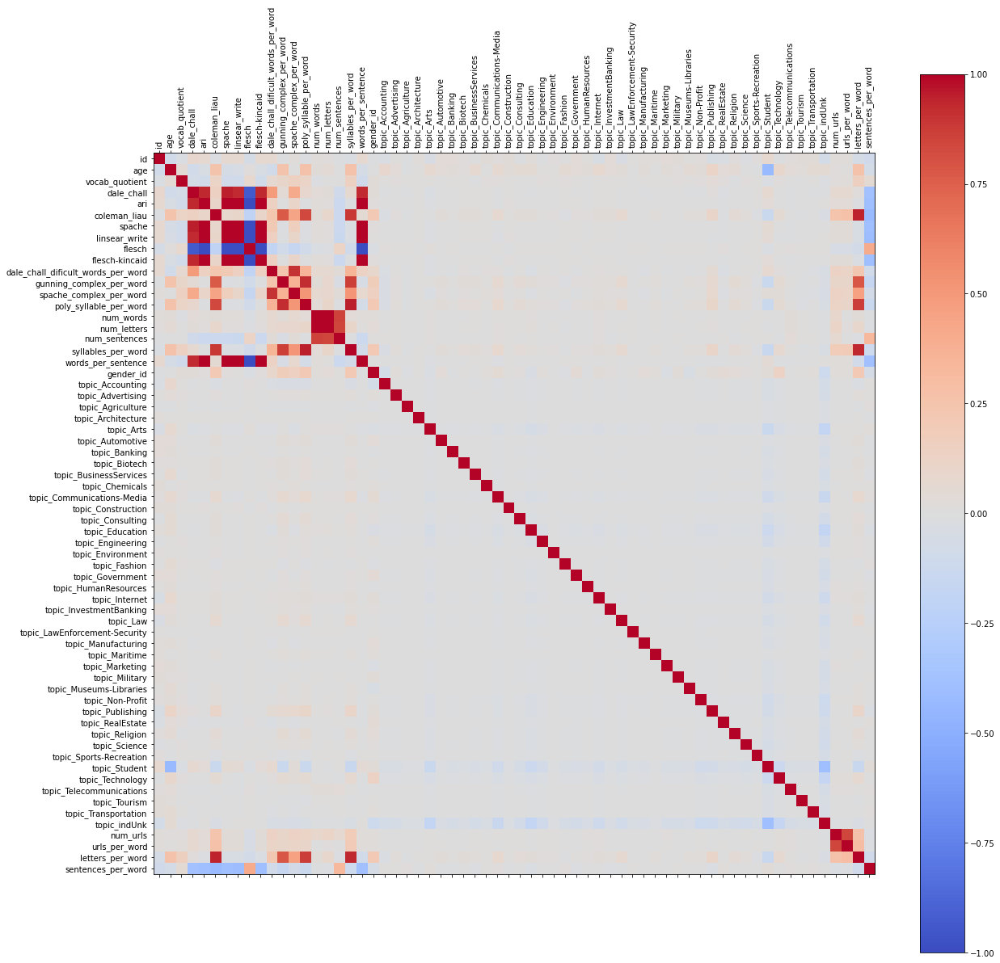

In [11]:
f, ax = subplots(1,1, figsize=(20,20));
matshow(lkdf.corr(), fignum=0, cmap="coolwarm", norm=colors.CenteredNorm());
colorbar();
ax.set_xticks(range(len(labels)));
ax.set_xticklabels(labels, rotation=90);
ax.set_yticks(range(len(labels)));
ax.set_yticklabels(labels, rotation=0);

It may be handy to view the correlations in bar-chart form.

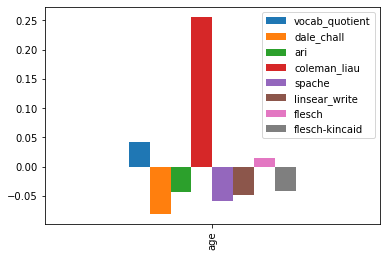

In [12]:
lkdf.corr().loc[["age"], score_functions].plot(kind="bar");

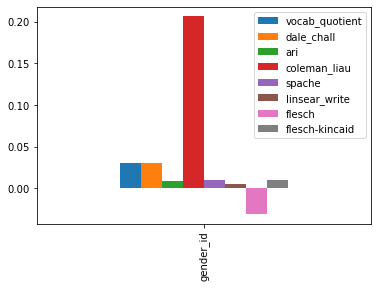

In [13]:
lkdf.corr().loc[["gender_id"], score_functions].plot(kind="bar");

Significant correlation is found between gender and Coleman-Liau formula values, as well as between age and Coleman-Liau values. The other formula are less biased.

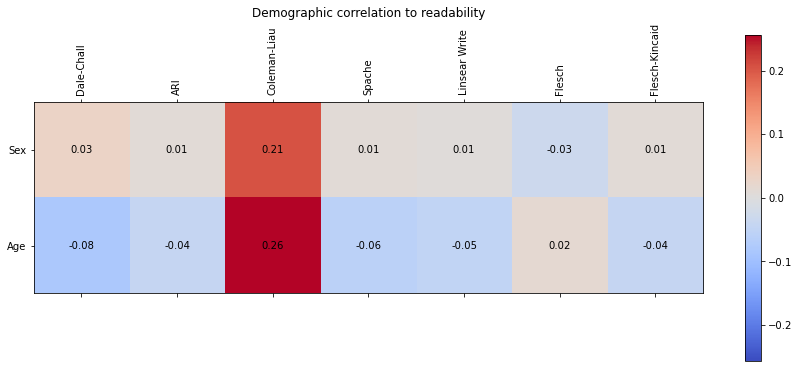

In [14]:
mat = lkdf.corr().loc[demographics, readability_functions]
f, ax = subplots(1,1, figsize=(15,6));
matshow(mat, fignum=0, cmap="coolwarm", norm=colors.CenteredNorm());
colorbar();
x_ticks = mat.columns
y_ticks = mat.index
ax.set_xticks(range(len(x_ticks)));
ax.set_xticklabels(readability_names, rotation=90);
ax.set_yticks(range(len(y_ticks)));
ax.set_yticklabels(demographics_names, rotation=0);
ax.set_title("Demographic correlation to readability")
for (i, j), z in np.ndenumerate(mat):
    ax.text(j, i, '{:0.2f}'.format(z), ha='center', va='center',)
            #bbox=dict(boxstyle='round', facecolor='white', edgecolor='0.3'))
plt.savefig("fig_2_demographics_vs_test.jpg", format="JPEG", dpi=400, bbox_inches="tight")

We can readily see that the sex and age bias in Coleman-Liau scores is caused by gender and age bias toward more complex words. The other stylistic features are mostly uncorrelated with sex and age.

In [15]:
lkdf.corr().loc[["gender_id"],["age"]]

,age
gender_id,-0.003039


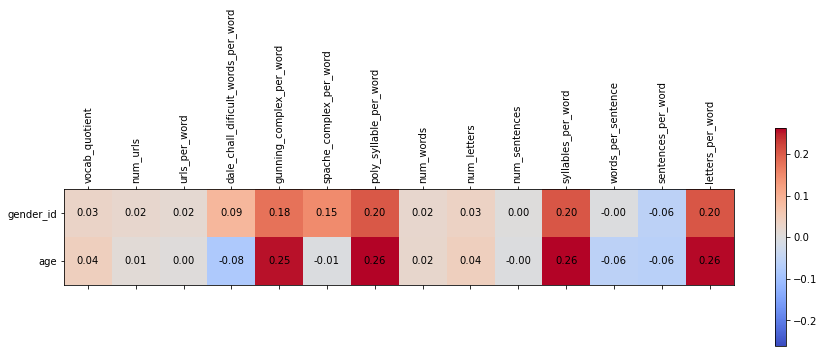

In [16]:
mat = lkdf.corr().loc[demographics, features]
f, ax = subplots(1,1, figsize=(15,4));
matshow(mat, fignum=0, cmap="coolwarm", norm=colors.CenteredNorm());
colorbar();
x_ticks = mat.columns
y_ticks = mat.index
ax.set_xticks(range(len(x_ticks)));
ax.set_xticklabels(x_ticks, rotation=90);
ax.set_yticks(range(len(y_ticks)));
ax.set_yticklabels(y_ticks, rotation=0);
for (i, j), z in np.ndenumerate(mat):
    ax.text(j, i, '{:0.2f}'.format(z), ha='center', va='center',)
            #bbox=dict(boxstyle='round', facecolor='white', edgecolor='0.3'))
plt.savefig("demographics_vs_feature.png")

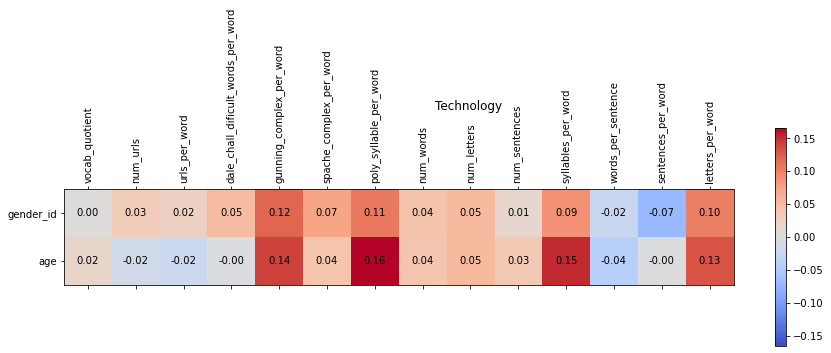

In [17]:
mat = lkdf[lkdf["topic"]=="Technology"].corr().loc[demographics, features]
f, ax = subplots(1,1, figsize=(15,4));
matshow(mat, fignum=0, cmap="coolwarm", norm=colors.CenteredNorm());
colorbar();
x_ticks = mat.columns
y_ticks = mat.index
ax.set_xticks(range(len(x_ticks)));
ax.set_xticklabels(x_ticks, rotation=90);
ax.set_yticks(range(len(y_ticks)));
ax.set_yticklabels(y_ticks, rotation=0);
f.suptitle("Technology")
for (i, j), z in np.ndenumerate(mat):
    ax.text(j, i, '{:0.2f}'.format(z), ha='center', va='center',)
            #bbox=dict(boxstyle='round', facecolor='white', edgecolor='0.3'))
plt.savefig("demographics_vs_feature.png")

### Investigating the gender and age bias toward longer words
A key question we should ask (and try to answer) is whether the observed gender and age bias toward more complex words is in fact a property of genuine differences in male/female or age-range communication styles or if it is explained by the profession of the writers (which is roughly connected to their blog content). 

First, the correlation of gender and age to each topic group.

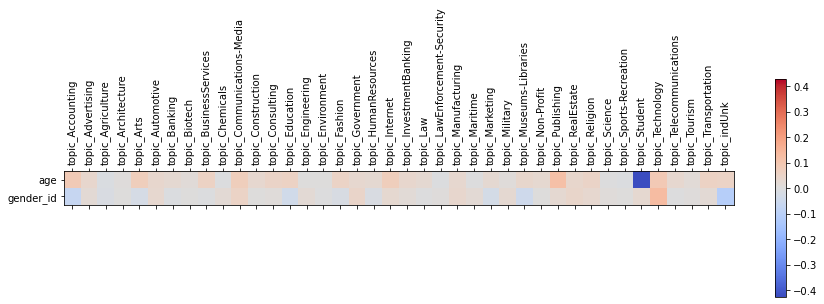

In [18]:
mat = lkdf.corr().loc[["age", "gender_id"], topics]
f, ax = subplots(1,1, figsize=(15,4));
matshow(mat, fignum=0, cmap="coolwarm", norm=colors.CenteredNorm());
colorbar();
x_ticks = mat.columns
y_ticks = mat.index
ax.set_xticks(range(len(x_ticks)));
ax.set_xticklabels(x_ticks, rotation=90);
ax.set_yticks(range(len(y_ticks)));
ax.set_yticklabels(y_ticks, rotation=0);

I want to know what the age distribution looks like in each profession. Let's consider a heat map of the means.

In [19]:
print(f"The mean age of all bloggers is {lkdf.age.mean()}")

The mean age of all bloggers is 24.771659521257593


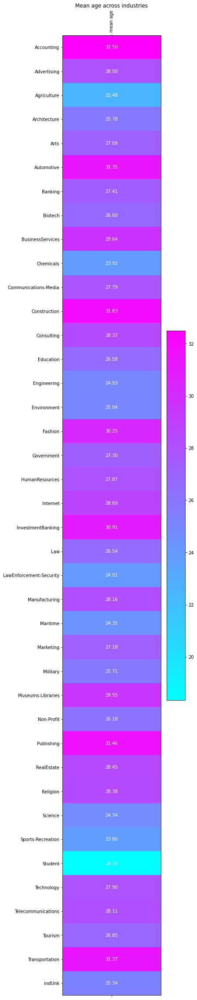

In [20]:
mean_age_by_topic = []
for topic in topics:
    mean_age_by_topic.append(array([lkdf[lkdf[topic]==1]["age"].values.mean()]))
mean_age_by_topic = array(mean_age_by_topic)
mat = mean_age_by_topic
f, ax = subplots(1,1, figsize=(5,40));
im = ax.matshow(mat, aspect="auto", cmap="cool");
colorbar(im, ax=ax);
x_ticks = ["mean age"]
y_ticks = [topic.split("_")[1] for topic in topics]
ax.set_title("Mean age across industries")
ax.set_xticks(range(len(x_ticks)));
ax.set_xticklabels(x_ticks, rotation=90);
ax.set_yticks(range(len(y_ticks)));
ax.set_yticklabels(y_ticks, rotation=0);
for (i, j), z in np.ndenumerate(mat):
    ax.text(j, i, '{:0.2f}'.format(z), ha='center', va='center', color="white")

Now let's consider what the sex distribution is like in the corpus in general and in each profession. By that we mean we will investigate how many posts are made by each sex in each work category. Recall that this is not, in fact, necessarily proportional to the actual sex bias of the industry. A convenient way to represent the male-female balance in a group is with the difference in the percent of males and females. That is,

$$
b = \frac{\text{number of males}-\text{number of females}}{\text{total number of individuals}}.
$$

In [21]:
m = lkdf[(lkdf["gender_id"]==1)].shape[0]
f = lkdf[(lkdf["gender_id"]==0)].shape[0]
t = lkdf[((lkdf["gender_id"]==0) | (lkdf["gender_id"]==1))].shape[0]
print(f"The corpus-wide male-female ballance is {(m-f)/t}")

The corpus-wide male-female ballance is -0.03065827081100393


This means there are slightly more (3%) female posts than male posts, but overall the balance is pretty even.

In [22]:
mf_ratios = []
print(f"{'topic':<30}{'males':<8}{'females':<8}{'balance':<20}")
for topic in topics:
    m = lkdf[(lkdf[topic]==1) & (lkdf["gender_id"]==1)].shape[0]
    f = lkdf[(lkdf[topic]==1) & (lkdf["gender_id"]==0)].shape[0]
    t = lkdf[(lkdf[topic]==1) & ((lkdf["gender_id"]==0) | (lkdf["gender_id"]==1))].shape[0]
    mf_ratios.append(array([(m-f)/t]))
    print(f"{topic:<30}{m:<8}{f:<8}{m/f:<20}")
mf_ratios = array(mf_ratios)

topic                         males   females balance             
topic_Accounting              66      617     0.10696920583468396 
topic_Advertising             355     239     1.4853556485355648  
topic_Agriculture             42      103     0.4077669902912621  
topic_Architecture            71      72      0.9861111111111112  
topic_Arts                    2101    2728    0.7701612903225806  
topic_Automotive              146     25      5.84                
topic_Banking                 217     287     0.7560975609756098  
topic_Biotech                 117     112     1.0446428571428572  
topic_BusinessServices        340     406     0.8374384236453202  
topic_Chemicals               167     81      2.0617283950617282  
topic_Communications-Media    1826    1086    1.6813996316758748  
topic_Construction            53      56      0.9464285714285714  
topic_Consulting              519     460     1.1282608695652174  
topic_Education               1944    2837    0.68523087768769

In [23]:
print(f"The most male-dominated group is {topics[mf_ratios.argmax()]}")

The most male-dominated group is topic_Automotive


In [24]:
print(f"The most female-dominated group is {topics[mf_ratios.argmin()]}")

The most female-dominated group is topic_Accounting


We'll now view this data as a heatmap.

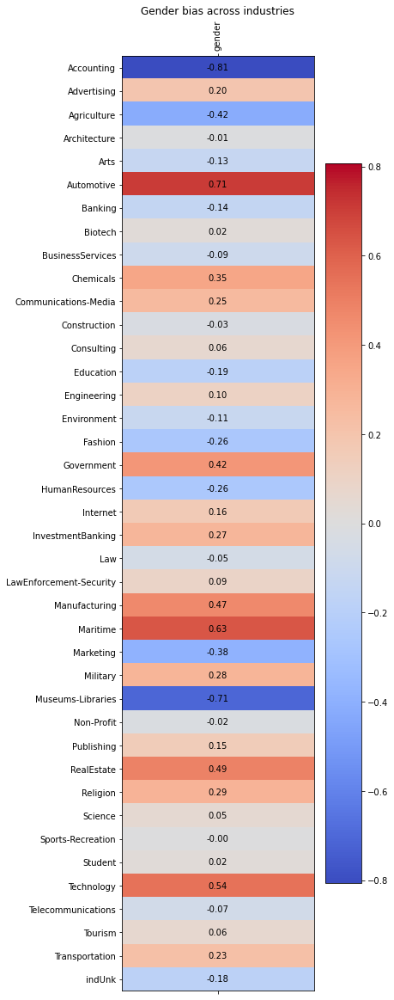

In [25]:
f, ax = subplots(1,1, figsize=(5,20));
im = ax.matshow(mf_ratios, aspect="auto", cmap="coolwarm", norm=colors.CenteredNorm());
colorbar(im, ax=ax);
x_ticks = ["gender"]
y_ticks = [topic.split("_")[1] for topic in topics]
ax.set_title("Gender bias across industries")
ax.set_xticks(range(len(x_ticks)));
ax.set_xticklabels(x_ticks, rotation=90);
ax.set_yticks(range(len(y_ticks)));
ax.set_yticklabels(y_ticks, rotation=0);
for (i, j), z in np.ndenumerate(mf_ratios):
    ax.text(j, i, '{:0.2f}'.format(z), ha='center', va='center', color="black")

Now let's consider the correlation between sex/age and the features and scoring functions (readability formulae)

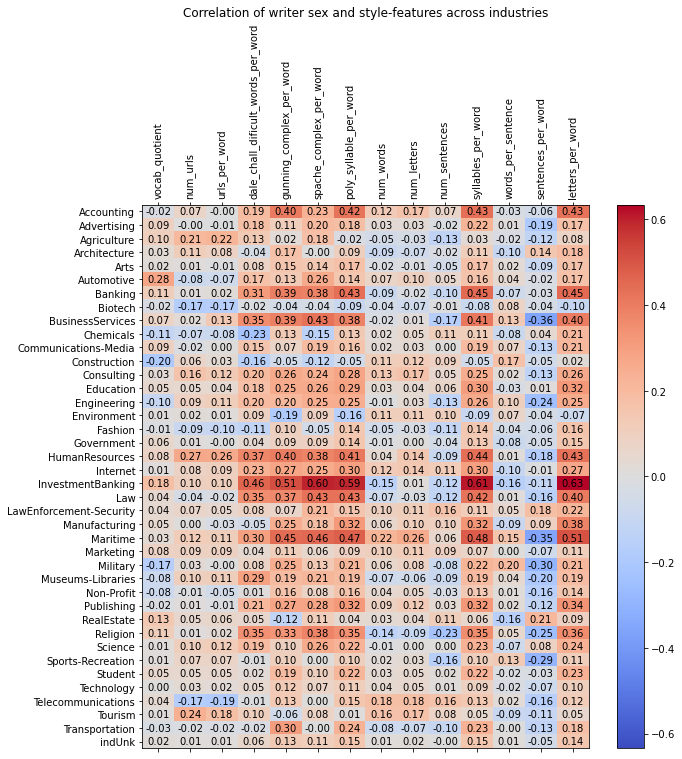

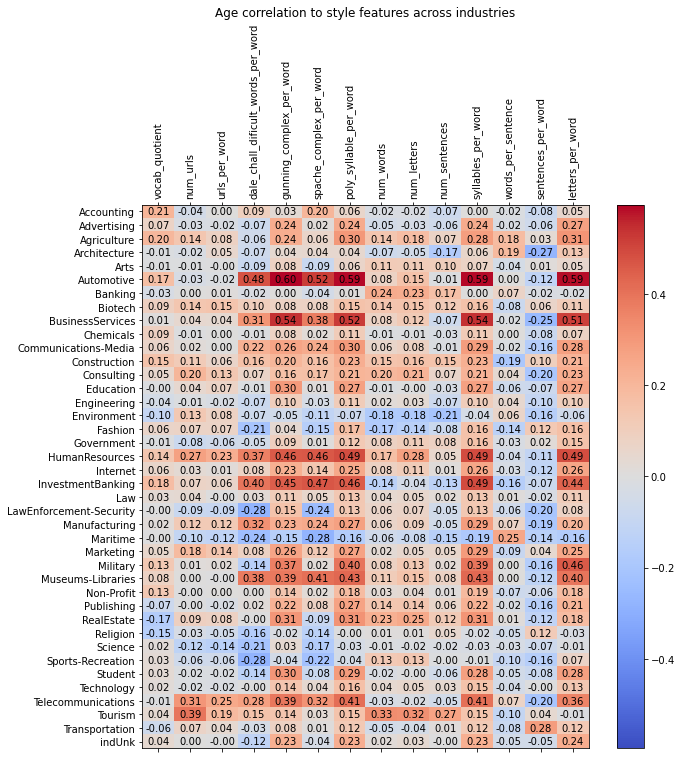

In [26]:
gender_corr_topics = []
age_corr_topics = []
for topic in topics:
    mat = lkdf[lkdf[topic]==1].corr().loc[demographics, features]
    gender_corr_topics.append(mat.loc["gender_id"].values)
    age_corr_topics.append(mat.loc["age"].values)

x_ticks = features
y_ticks = [topic.split("_")[1] for topic in topics]
f, ax = subplots(1,1, figsize=(10,10));
m1 = ax.matshow(array(gender_corr_topics), aspect='auto', cmap="coolwarm", norm=colors.CenteredNorm());
ax.set_title("Correlation of writer sex and style-features across industries")
ax.set_xticks(range(len(x_ticks)));
ax.set_xticklabels(x_ticks, rotation=90);
ax.set_yticks(range(len(y_ticks)));
ax.set_yticklabels(y_ticks, rotation=0);
for (i, j), z in np.ndenumerate(gender_corr_topics):
    ax.text(j, i, '{:0.2f}'.format(z), ha='center', va='center', color="black")
#            bbox=dict(boxstyle='round', facecolor='white', edgecolor='0.3'))
colorbar(m1, ax=ax);    
plt.savefig("fig_3_sex_correlation_features_by_industry.jpg", format="JPEG", dpi=400, bbox_inches="tight")

f, ax = subplots(1,1, figsize=(10,10));
m1 = ax.matshow(array(age_corr_topics), aspect='auto', cmap="coolwarm", norm=colors.CenteredNorm());
ax.set_title("Age correlation to style features across industries")
ax.set_xticks(range(len(x_ticks)));
ax.set_xticklabels(x_ticks, rotation=90);
ax.set_yticks(range(len(y_ticks)));
ax.set_yticklabels(y_ticks, rotation=0);
for (i, j), z in np.ndenumerate(age_corr_topics):
    ax.text(j, i, '{:0.2f}'.format(z), ha='center', va='center', color="black")
#            bbox=dict(boxstyle='round', facecolor='white', edgecolor='0.3'))
colorbar(m1, ax=ax);    

The correlations vary a lot depending on the profession. However, the most female-dominated profession (accounting) still has significant correlation between word complexity and being male. This correlation is even stronger than what we see in the most male-dominated profession.  

I want to know if age explains these score differences. This requires that we figure out the age distribution for each of these topics and gender groups and see if that explains why they score so differently.

In [27]:
print("Spache complex words per word means by topic and gender")
print(f"{'topic':<30}{'obs':<8}{'age':<20}{'female':<20}{'obs':<8}{'age':<20}{'male':<20}")
for topic in topics:
    m = lkdf[(lkdf[topic]==1) & (lkdf["gender_id"]==1)].shape[0]
    f = lkdf[(lkdf[topic]==1) & (lkdf["gender_id"]==0)].shape[0]
    fm = lkdf[(lkdf[topic]==1) & lkdf["gender_id"]==0]["spache_complex_per_word"].values.mean()
    mm = lkdf[(lkdf[topic]==1) & lkdf["gender_id"]==1]["spache_complex_per_word"].values.mean()
    fa = lkdf[(lkdf[topic]==1) & lkdf["gender_id"]==0]["age"].values.mean()
    ma = lkdf[(lkdf[topic]==1) & lkdf["gender_id"]==1]["age"].values.mean()
    print(f"{topic:<30}{f:<8}{fa:<20}{fm:<20}{m:<8}{ma:<20}{mm:<20}")

Spache complex words per word means by topic and gender
topic                         obs     age                 female              obs     age                 male                
topic_Accounting              617     24.77217268887846   0.27681615385771385 66      24.075757575757574  0.289863073537054   
topic_Advertising             239     24.758252721015996  0.27672859238927805 355     28.140845070422536  0.3012463453574393  
topic_Agriculture             103     24.773194379286466  0.2768318968442253  42      21.5                0.2637611559627354  
topic_Architecture            72      24.77119903460451   0.27682456655075877 71      25.35211267605634   0.27833989906047535 
topic_Arts                    2728    24.731258646117965  0.27677253272459057 2101    26.453593526891957  0.2790420017157504  
topic_Automotive              25      24.760651741182258  0.27678726446862284 146     31.513698630136986  0.3004082336531522  
topic_Banking                 287     24.76742286040447

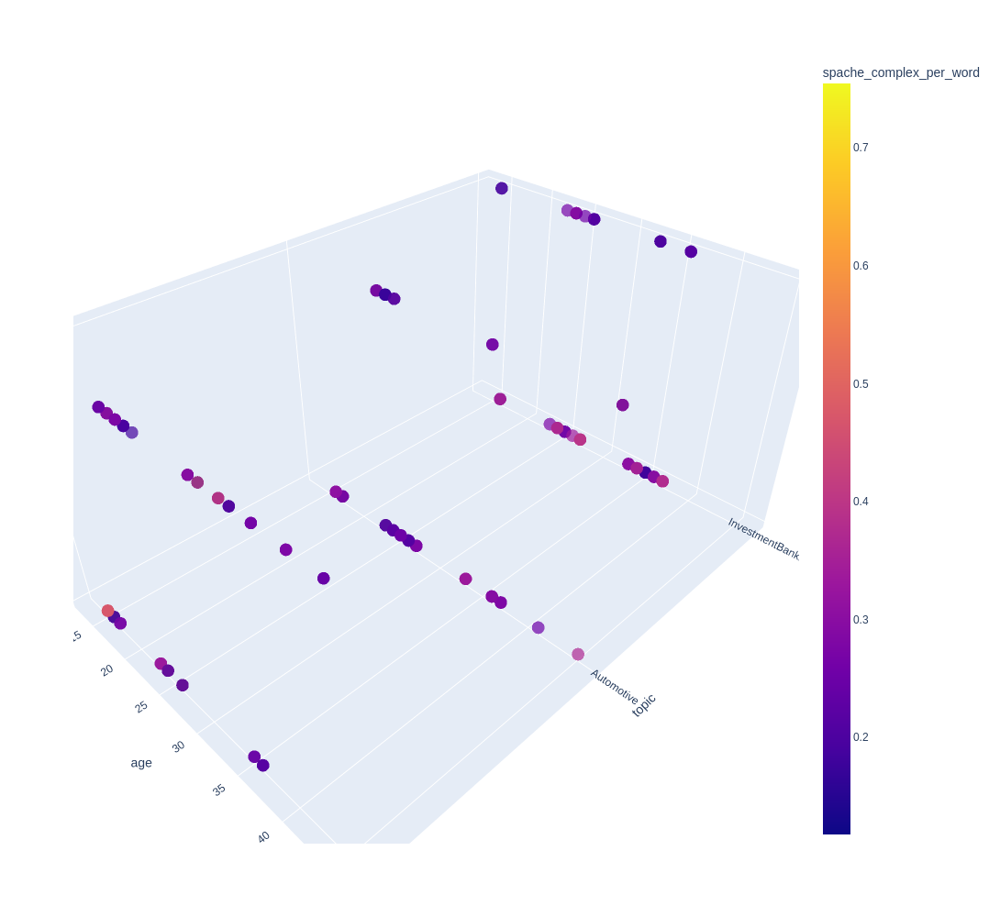

In [28]:
fig = px.scatter_3d(lkdf[(lkdf['topic_InvestmentBanking']==1)|(lkdf['topic_Fashion']==1)| (lkdf['topic_Automotive']==1)], x='topic', y='age', z='gender',
              color='spache_complex_per_word', hover_data=None, width=1000, height=1000, opacity=.7)
fig.show()

### How similar are the readability formulae?
We'll check this with Pearson correlation.

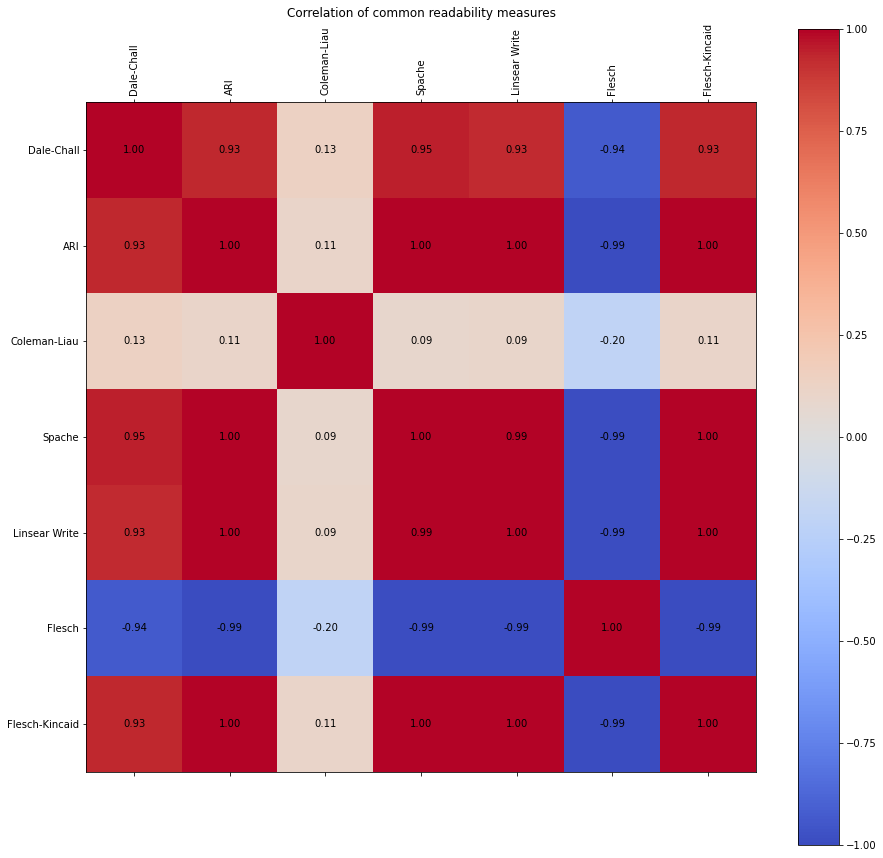

In [29]:
mat = lkdf.corr().loc[readability_functions, readability_functions]
f, ax = subplots(1,1, figsize=(15,15));
matshow(mat, fignum=0, cmap="coolwarm", norm=colors.CenteredNorm());
colorbar();
x_ticks = mat.columns
y_ticks = mat.index
ax.set_xticks(range(len(x_ticks)));
ax.set_xticklabels(readability_names, rotation=90);
ax.set_yticks(range(len(y_ticks)));
ax.set_yticklabels(readability_names, rotation=0);
for (i, j), z in np.ndenumerate(mat):
    ax.text(j, i, '{:0.2f}'.format(z), ha='center', va='center', color="black")
#            bbox=dict(boxstyle='round', facecolor='white', edgecolor='0.3'))
ax.set_title("Correlation of common readability measures");
plt.savefig("fig_1_test_test_corr.jpg", dpi=400, format="JPEG")

The standard approaches are all pretty much the same except for the Coleman-Liau formula, which is very different. Vocabulary entropy is essentially unrelated to all the standard tools.

### How does each vocation perform in terms of the scoring functions?

We can use Pearson correlation to determine if any of the vocations are strongly related to the various scores.

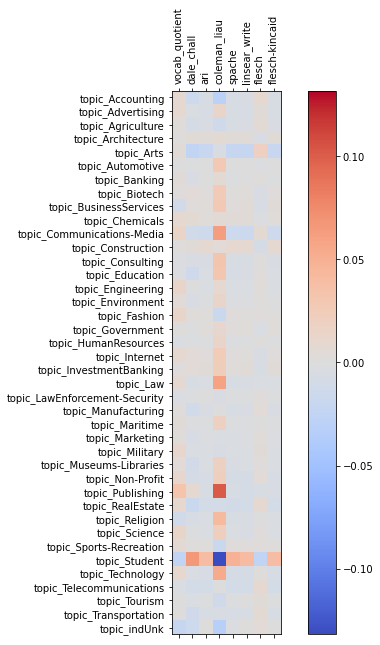

In [30]:
score_topic_corr = lkdf.corr().loc[topics, score_functions]
f, ax = subplots(1,1, figsize=(10,10));
matshow(score_topic_corr, fignum=0, cmap="coolwarm", norm=colors.CenteredNorm());
colorbar();
x_ticks = score_topic_corr.columns
y_ticks = score_topic_corr.index
ax.set_xticks(range(len(x_ticks)));
ax.set_xticklabels(x_ticks, rotation=90);
ax.set_yticks(range(len(y_ticks)));
ax.set_yticklabels(y_ticks, rotation=0);

### What age author writes the most simply?

We could approach this question by plotting the mean score for each age group.

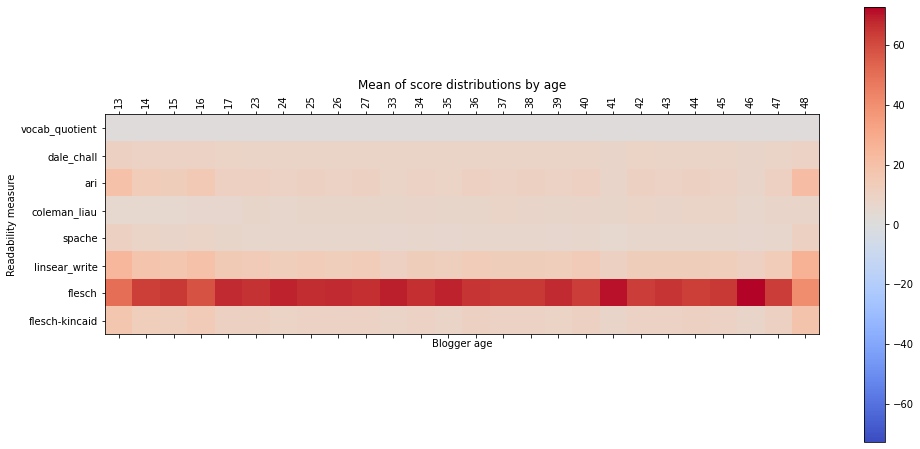

In [31]:
#score_functions = ["vocab_quotient","dale_chall", "ari", "coleman_liau", "spache", "linsear_write", "flesch", "flesch-kincaid"]
stds = array([array([mean(lkdf[lkdf["age"]==a][score].values) for a in ages]) for score in score_functions])
f, ax = subplots(1,1, figsize=(16,8));
matshow(stds, fignum=0, cmap="coolwarm", norm=colors.CenteredNorm());
colorbar();
x_ticks = ages
y_ticks = score_functions
ax.set_title("Mean of score distributions by age")
ax.set_xlabel("Blogger age")
ax.set_ylabel("Readability measure")
ax.set_xticks(range(len(x_ticks)));
ax.set_xticklabels(x_ticks, rotation=90);
ax.set_yticks(range(len(y_ticks)));
ax.set_yticklabels(y_ticks, rotation=0);

That plot shows that the very youngest and the very oldest ages observed produce text with the lowest readability scores (i.e. the most simple text). But it is a little difficult to read. The result is easier to discern in the Mean-Mean-Ratio plot below, which divides the mean score for each age group by the overall mean score for all ages.

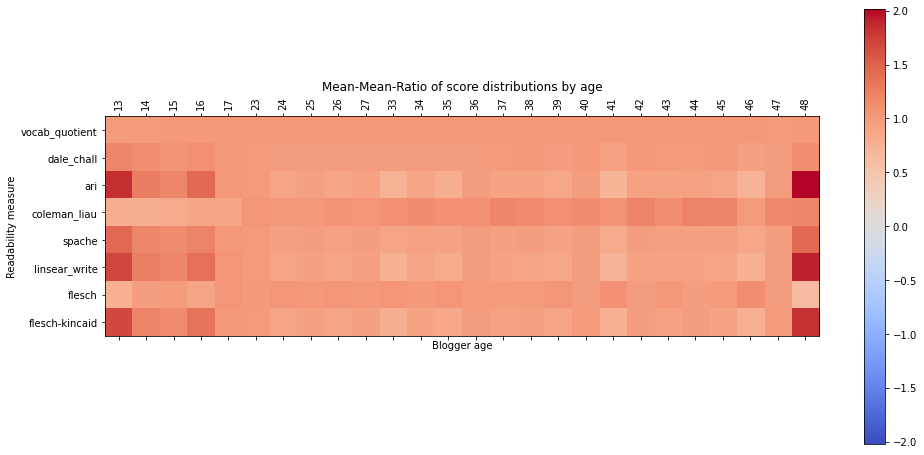

In [32]:
means = array([array([mean(lkdf[lkdf["age"]==a][score].values)/mean(lkdf[score].values) for a in ages]) for score in score_functions])
f, ax = subplots(1,1, figsize=(16,8));
matshow(means, fignum=0, cmap="coolwarm", norm=colors.CenteredNorm());
colorbar();
x_ticks = ages
y_ticks = score_functions
ax.set_title("Mean-Mean-Ratio of score distributions by age")
ax.set_xlabel("Blogger age")
ax.set_ylabel("Readability measure")
ax.set_xticks(range(len(x_ticks)));
ax.set_xticklabels(x_ticks, rotation=90);
ax.set_yticks(range(len(y_ticks)));
ax.set_yticklabels(y_ticks, rotation=0);

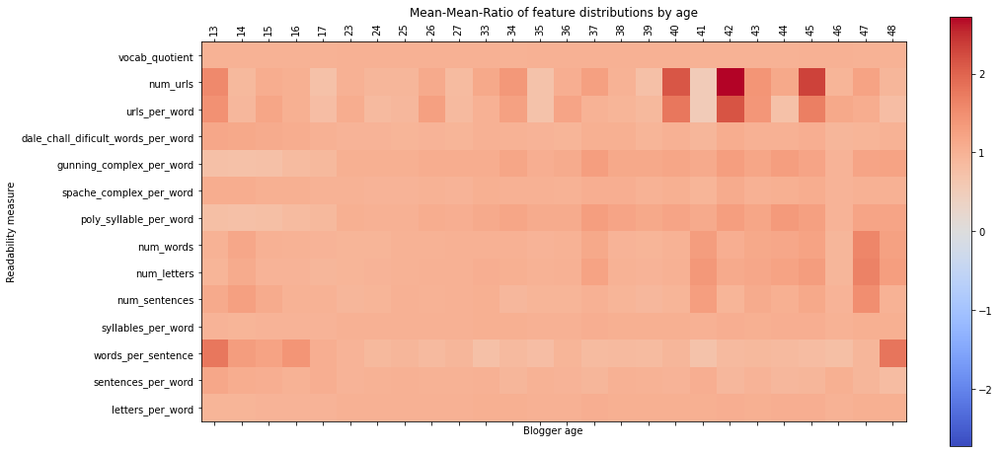

In [33]:
means = array([array([mean(lkdf[lkdf["age"]==a][score].values)/mean(lkdf[score].values) for a in ages]) for score in features])
f, ax = subplots(1,1, figsize=(16,8));
matshow(means, fignum=0, cmap="coolwarm", norm=colors.CenteredNorm());
colorbar();
x_ticks = ages
y_ticks = features
ax.set_title("Mean-Mean-Ratio of feature distributions by age")
ax.set_xlabel("Blogger age")
ax.set_ylabel("Readability measure")
ax.set_xticks(range(len(x_ticks)));
ax.set_xticklabels(x_ticks, rotation=90);
ax.set_yticks(range(len(y_ticks)));
ax.set_yticklabels(y_ticks, rotation=0);

Again we face the causation attribution problem -- do young writers and old writers use simpler words because of their age, or because at those bookend ages they are less likely to be learning new things, and therefore the vocation is to blame?

To understand where the variance is distributed, we will review the Sigma-Sigma-Ratio of the score distributions, meaning that for each score and each age group we divide the standard deviation for that age group by the standard deviation for all age groups. 

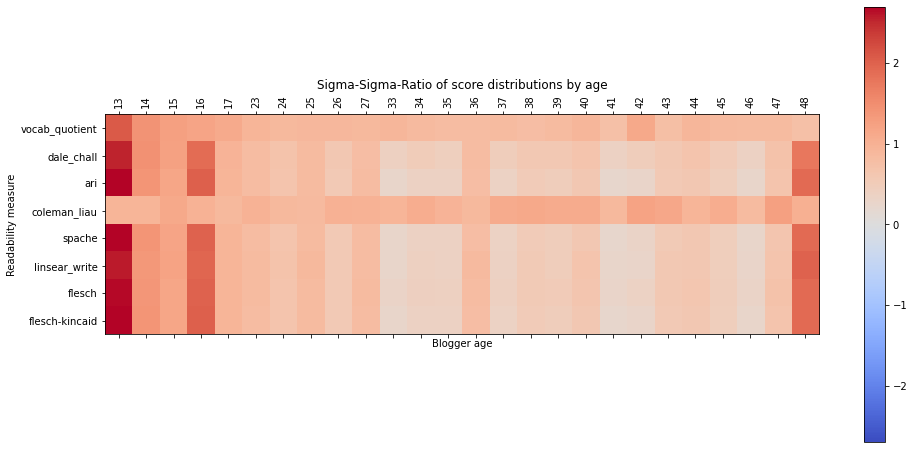

In [34]:
stds = array([array([lkdf[lkdf["age"]==a][score].values.std()/lkdf[score].values.std() for a in ages]) for score in score_functions])
f, ax = subplots(1,1, figsize=(16,8));
matshow(stds, fignum=0, cmap="coolwarm", norm=colors.CenteredNorm());
colorbar();
x_ticks = ages
y_ticks = score_functions
ax.set_title("Sigma-Sigma-Ratio of score distributions by age")
ax.set_xlabel("Blogger age")
ax.set_ylabel("Readability measure")
ax.set_xticks(range(len(x_ticks)));
ax.set_xticklabels(x_ticks, rotation=90);
ax.set_yticks(range(len(y_ticks)));
ax.set_yticklabels(y_ticks, rotation=0);

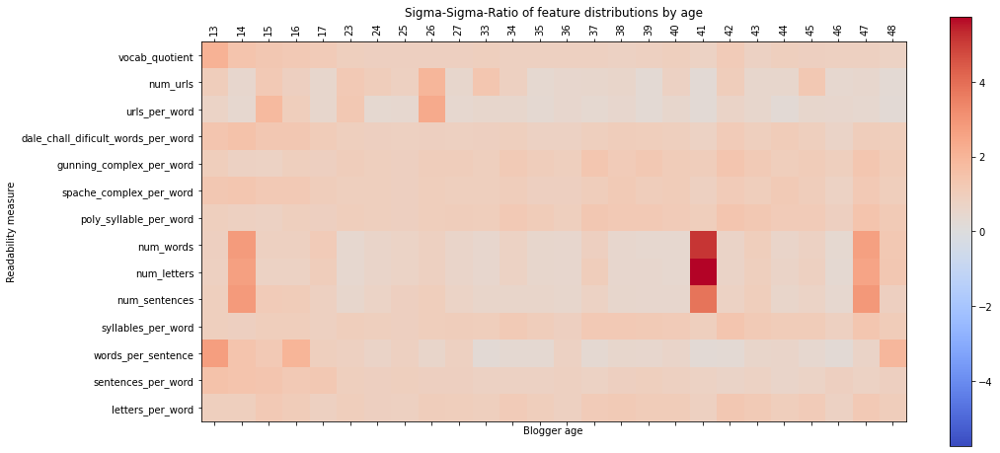

In [35]:
stds = array([array([lkdf[lkdf["age"]==a][score].values.std()/lkdf[score].values.std() for a in ages]) for score in features])
f, ax = subplots(1,1, figsize=(16,8));
matshow(stds, fignum=0, cmap="coolwarm", norm=colors.CenteredNorm());
colorbar();
x_ticks = ages
y_ticks = features
ax.set_title("Sigma-Sigma-Ratio of feature distributions by age")
ax.set_xlabel("Blogger age")
ax.set_ylabel("Readability measure")
ax.set_xticks(range(len(x_ticks)));
ax.set_xticklabels(x_ticks, rotation=90);
ax.set_yticks(range(len(y_ticks)));
ax.set_yticklabels(y_ticks, rotation=0);

For most of the score functions, the bookend ages have the most variance. Coleman-Liau is surprisingly smooth, however. This is because of the smooth age correlation with letters per word and sentences per word. 

Separate the scores by topic and by gender, and also by age and by gender.

In [36]:
gender_score_corr = [[lkdf[lkdf[topic]==1]["gender_id"].corr(lkdf[lkdf[topic]==1][score]) for topic in topics] for score in score_functions]

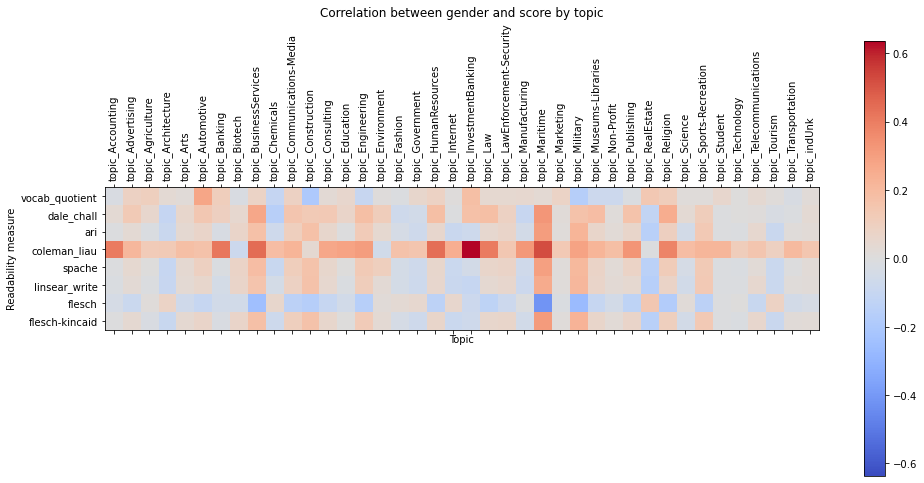

In [37]:
f, ax = subplots(1,1, figsize=(16,8));
matshow(gender_score_corr, fignum=0, cmap="coolwarm", norm=colors.CenteredNorm());
colorbar();
x_ticks = topics
y_ticks = score_functions
ax.set_title("Correlation between gender and score by topic")
ax.set_xlabel("Topic")
ax.set_ylabel("Readability measure")
ax.set_xticks(range(len(x_ticks)));
ax.set_xticklabels(x_ticks, rotation=90);
ax.set_yticks(range(len(y_ticks)));
ax.set_yticklabels(y_ticks, rotation=0);

In [38]:
lkdf.loc[lkdf[lkdf["topic"]=="InvestmentBanking"]["coleman_liau"].idxmax()].text

"             What is it about  urlLink Dahlia Lithwick  that makes her repeatedly come close to a great idea and then suddenly drop the ball?  There is probably nothing I can do or say to convince you that the words 'activist judge' have no more meaning than the words 'hectic smurlbats.' You've heard 'activist judges' so many times - from the president, from Congress, from the angry guys on the radio - that you can define it right along with me.  Together then: Liberal activist judges make law, as opposed to interpreting it. They ignore the plain meaning of texts to invent new rights. Superimposing their moral views onto their legal reasoning, they brazenly advance the cause of the fringe liberal elites in the culture wars. That certainly sounds right. Justice Antonin Scalia would say it better, of course. He'd make reference to the framers and toss in words like  kulturkampf .  The sarcasm seems well-placed so far.  Re-activist judges are able to present themselves as 'strict constru

The reason Coleman-Liau scores so highly on some blog posts is usually that those posts include a lot of URLs. This is because the statistic heavily weights the number of letters per word, and URL's are considered a single word. This can be used to find weirdly URL-heavy text. Is the gender bias of the Coleman-Liau test related to the bias of a gender to use URL's in a text post?

In [39]:
len(extractor.find_urls(lkdf.loc[lkdf[lkdf["topic"]=="Technology"]["coleman_liau"].idxmax()].text))

168

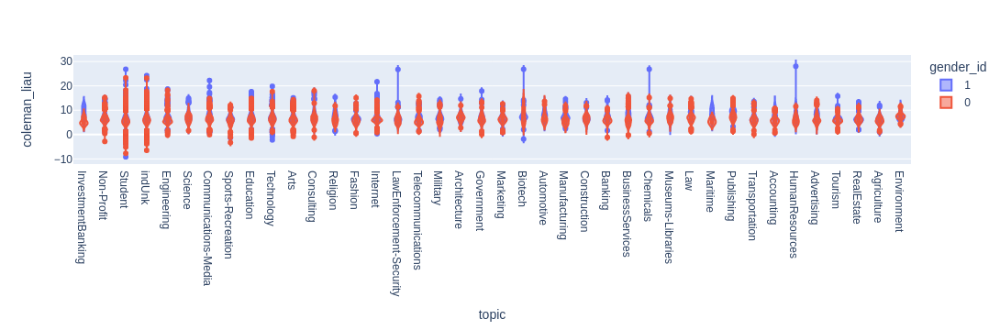

In [40]:
fig = px.violin(lkdf[lkdf["num_urls"]==0], x="topic", y="coleman_liau", color="gender_id", box=True, violinmode='overlay')
fig.show()

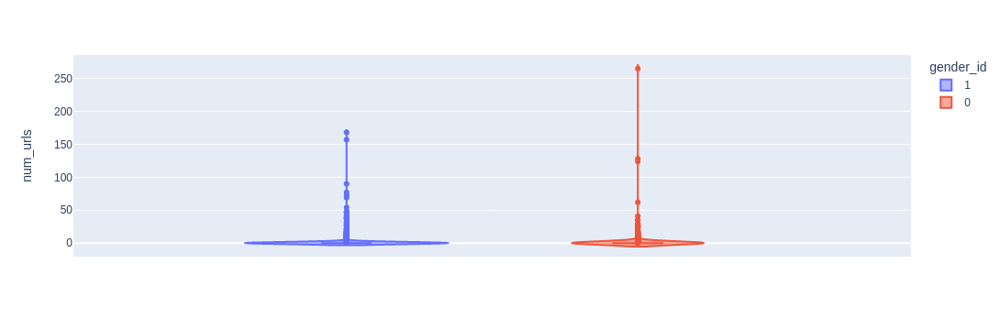

In [41]:
fig = px.violin(lkdf, y="num_urls", color="gender_id", box=True)
fig.show()

In [42]:
def print_gender_stats(item, df=lkdf):
    print(item, "by gender")
    print(f"{'':<8} {'male':<20} {'female':<20}")
    print(f"{'mean':<8} {df[df.gender_id==1][item].values.mean():<20} {df[df.gender_id==0][item].values.mean():<20}")
    print(f"{'std':<8} {df[df.gender_id==1][item].values.std():<20} {df[df.gender_id==0][item].values.std():<20}")
    print(f"{'median':<8} {median(df[df.gender_id==1][item].values):<20} {median(df[df.gender_id==0][item].values):<20}")

In [43]:
print_gender_stats("num_urls")

num_urls by gender
         male                 female              
mean     0.22222478173734767  0.14636999805013323 
std      1.7743861444055595   1.7261626278526616  
median   0.0                  0.0                 


In [44]:
print_gender_stats("age")

age by gender
         male                 female              
mean     24.7469305014858     24.794917347314602  
std      7.743030579278493    8.030649910817539   
median   24.0                 24.0                


In [45]:
print_gender_stats("num_urls")

num_urls by gender
         male                 female              
mean     0.22222478173734767  0.14636999805013323 
std      1.7743861444055595   1.7261626278526616  
median   0.0                  0.0                 


In [46]:
for score in score_functions:
    print_gender_stats(score)
    print()

vocab_quotient by gender
         male                 female              
mean     0.8977418733528522   0.895748140752382   
std      0.03220835606210139  0.03341559006075402 
median   0.9013979635724954   0.8997130753889031  

dale_chall by gender
         male                 female              
mean     8.58819570750853     8.396203855311567   
std      3.222016784393324    3.0396960188716386  
median   8.06651091954023     7.789905185110461   

ari by gender
         male                 female              
mean     10.942471561797694   10.42093024700978   
std      28.82075764840314    26.544572381997593  
median   7.082840759395584    5.949114055543777   

coleman_liau by gender
         male                 female              
mean     7.188147986705799    6.253083405148483   
std      2.35319883732839     2.0860928554898663  
median   6.871087719298242    6.054362272240084   

spache by gender
         male                 female              
mean     6.860427521538168   

In [47]:
lkdf[lkdf.gender_id==0].num_urls.values.mean()

0.14636999805013323

In [48]:
lkdf["num_urls"].corr(lkdf["gender_id"])

0.021661223886189244

In [49]:
lkdf["coleman_liau"].corr(lkdf["gender_id"])

0.20602516855262493

In [50]:
lkdf[lkdf["num_urls"]==0]["coleman_liau"].corr(lkdf[lkdf["num_urls"]==0]["gender_id"])

0.21110782119058583

It turns out the gender bias for Coleman-Liau results is only increased when you restrict the comparison to only texts without URL references.

In [51]:
lkdf["coleman_liau"].corr(lkdf["num_urls"])

0.2436477807085441

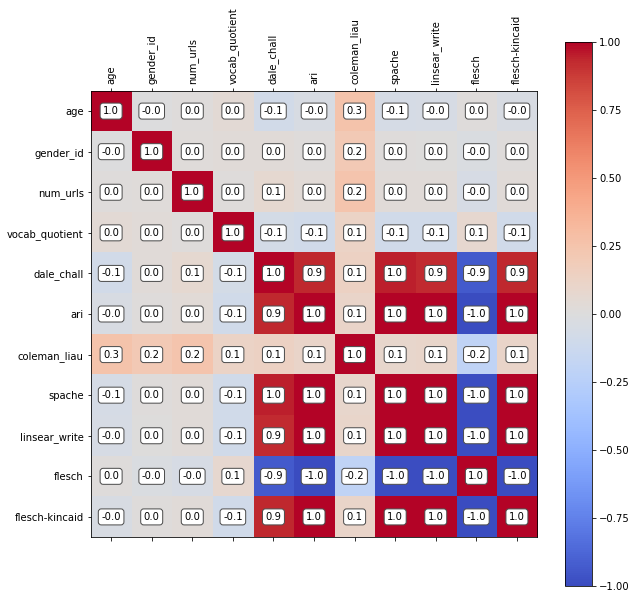

In [52]:
score_topic_corr = lkdf.corr().loc[["age", "gender_id", "num_urls"] + score_functions, ["age", "gender_id", "num_urls"] + score_functions]
f, ax = subplots(1,1, figsize=(10,10));
matshow(score_topic_corr, fignum=0, cmap="coolwarm", norm=colors.CenteredNorm());
colorbar();
x_ticks = score_topic_corr.columns
y_ticks = score_topic_corr.index
ax.set_xticks(range(len(x_ticks)));
ax.set_xticklabels(x_ticks, rotation=90);
ax.set_yticks(range(len(y_ticks)));
ax.set_yticklabels(y_ticks, rotation=0);
for (i, j), z in np.ndenumerate(score_topic_corr):
    ax.text(j, i, '{:0.1f}'.format(z), ha='center', va='center',
            bbox=dict(boxstyle='round', facecolor='white', edgecolor='0.3'))

### Quick review of time series data

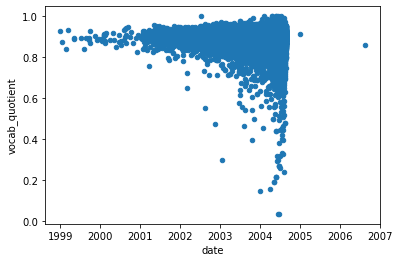

In [53]:
lkdf.plot("date", "vocab_quotient", kind="scatter");

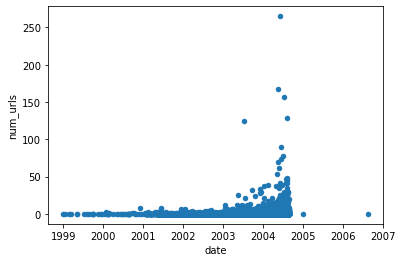

In [54]:
lkdf.plot("date", "num_urls", kind="scatter");

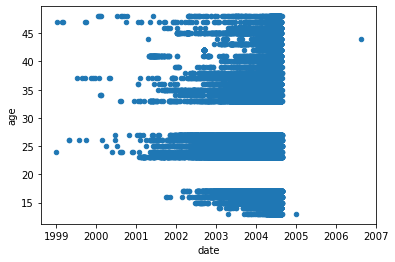

In [55]:
lkdf.plot("date", "age", kind="scatter");

In [56]:
num_bins = 50
start = lkdf.date.min()
stop = lkdf.date.max()
lifetime = stop - start
delta_t = lifetime/num_bins

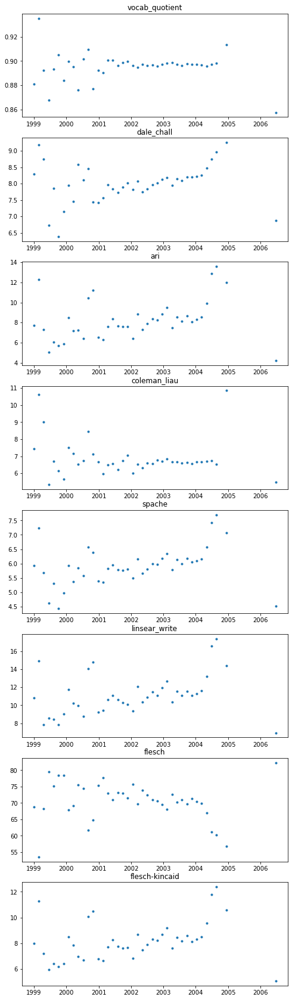

In [57]:
fig, ax = subplots(nrows=len(score_functions), ncols=1, figsize=(8,30))
for j in range(len(score_functions)):
    item = score_functions[j]
    means = [lkdf[(lkdf["date"]>=start + i*delta_t) & (lkdf["date"]<=start + (i+1)*delta_t)][item].mean() for i in range(num_bins)]
    ax[j].plot_date([start+ i*delta_t for i in range(num_bins)], means, ".");
    ax[j].set_title(item)

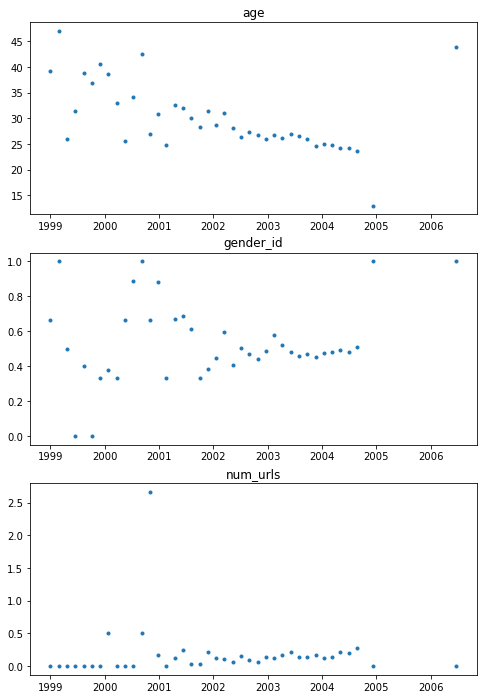

In [58]:
items = ["age", "gender_id", "num_urls"]
fig, ax = subplots(nrows=len(items), ncols=1, figsize=(8,4*len(items)))
for j in range(len(items)):
    item = items[j]
    means = [lkdf[(lkdf["date"]>=start + i*delta_t) & (lkdf["date"]<=start + (i+1)*delta_t)][item].mean() for i in range(num_bins)]
    ax[j].plot_date([start+ i*delta_t for i in range(num_bins)], means, ".");
    ax[j].set_title(item)

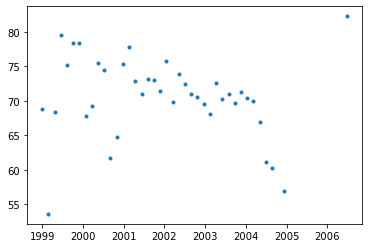

In [59]:
flesch_means = [lkdf[(lkdf["date"]>=start + i*delta_t) & (lkdf["date"]<=start + (i+1)*delta_t)]["flesch"].mean() for i in range(num_bins)]
plot_date([start+ i*delta_t for i in range(num_bins)], flesch_means, ".");

In [60]:
lkdf.gender_id.corr(lkdf["date"].dt.day_of_week)

-0.020715412789566293

In [61]:
week_day = lkdf["date"].dt.day_of_week

In [62]:
int_timestamp = lkdf.date.apply(lambda x: x.value)

In [63]:
print(f'{"item":<15} {"timestamp":<25} {"day of week":<25}')
for item in score_functions:
    print(f"{item:<15} {lkdf[item].corr(int_timestamp):<25} {lkdf[item].corr(week_day):<25}")

item            timestamp                 day of week              
vocab_quotient  -0.0005916052662797636    0.0002838399642610074    
dale_chall      0.017521490869242533      0.006510797643159811     
ari             0.011699741105296375      0.010560418357768091     
coleman_liau    -0.00210897034134087      -0.026695969961447512    
spache          0.01308549669963414       0.01071755463463748      
linsear_write   0.012269473710260074      0.010778177691837226     
flesch          -0.01222525220459763      -0.007318409553396807    
flesch-kincaid  0.012152264306631714      0.010409325329558874     


In [64]:
print(f'{"item":<15} {"timestamp":<25} {"day of week":<25}')
for item in ["age", "gender_id", "num_urls"]:
    print(f"{item:<15} {lkdf[item].corr(int_timestamp):<25} {lkdf[item].corr(week_day):<25}")

item            timestamp                 day of week              
age             -0.02843901331796923      -0.0357146770356459      
gender_id       -0.007340798060275335     -0.020715412789566293    
num_urls        0.003617755305257587      -0.005819936690643334    


In [65]:
print(f'{"item":<30} {"timestamp":<25} {"day of week":<25}')
for item in topics:
    print(f"{item:<30} {lkdf[item].corr(int_timestamp):<25} {lkdf[item].corr(week_day):<25}")

item                           timestamp                 day of week              
topic_Accounting               -0.0063132369811282245    -0.0023737386158756107   
topic_Advertising              0.00037550521848056897    -0.011677129348767884    
topic_Agriculture              -0.000662697894771578     0.002286984758446044     
topic_Architecture             0.0030367265211962845     0.00639661677074332      
topic_Arts                     -0.001979880849458911     -0.014903009494602382    
topic_Automotive               0.003224903497353619      0.0019605082083875556    
topic_Banking                  0.005267429046141243      0.004687457784722945     
topic_Biotech                  0.0034644238467627696     -0.0016952389109729537   
topic_BusinessServices         0.003021568159072369      -0.007434554725713964    
topic_Chemicals                0.0037086434569844526     -0.01644172261265049     
topic_Communications-Media     0.004305928287245667      -0.018176482497700333    
topi

In [66]:
print(f'{"item":<30} {"timestamp":<25} {"day of week":<25}')
for item in topics:
    print(f"{item:<30} {lkdf[item].corr(int_timestamp):<25} {lkdf[item].corr(week_day):<25}")

item                           timestamp                 day of week              
topic_Accounting               -0.0063132369811282245    -0.0023737386158756107   
topic_Advertising              0.00037550521848056897    -0.011677129348767884    
topic_Agriculture              -0.000662697894771578     0.002286984758446044     
topic_Architecture             0.0030367265211962845     0.00639661677074332      
topic_Arts                     -0.001979880849458911     -0.014903009494602382    
topic_Automotive               0.003224903497353619      0.0019605082083875556    
topic_Banking                  0.005267429046141243      0.004687457784722945     
topic_Biotech                  0.0034644238467627696     -0.0016952389109729537   
topic_BusinessServices         0.003021568159072369      -0.007434554725713964    
topic_Chemicals                0.0037086434569844526     -0.01644172261265049     
topic_Communications-Media     0.004305928287245667      -0.018176482497700333    
topi

In [67]:
lkdf.columns

Index(['id', 'gender', 'age', 'topic', 'sign', 'date', 'text', 'tokens',
       'lang', 'vocab_quotient', 'dale_chall', 'ari', 'coleman_liau', 'spache',
       'linsear_write', 'flesch', 'flesch-kincaid',
       'dale_chall_dificult_words_per_word', 'gunning_complex_per_word',
       'spache_complex_per_word', 'poly_syllable_per_word', 'num_words',
       'num_letters', 'num_sentences', 'syllables_per_word',
       'words_per_sentence', 'gender_id', 'topic_Accounting',
       'topic_Advertising', 'topic_Agriculture', 'topic_Architecture',
       'topic_Arts', 'topic_Automotive', 'topic_Banking', 'topic_Biotech',
       'topic_BusinessServices', 'topic_Chemicals',
       'topic_Communications-Media', 'topic_Construction', 'topic_Consulting',
       'topic_Education', 'topic_Engineering', 'topic_Environment',
       'topic_Fashion', 'topic_Government', 'topic_HumanResources',
       'topic_Internet', 'topic_InvestmentBanking', 'topic_Law',
       'topic_LawEnforcement-Security', 'topic_M

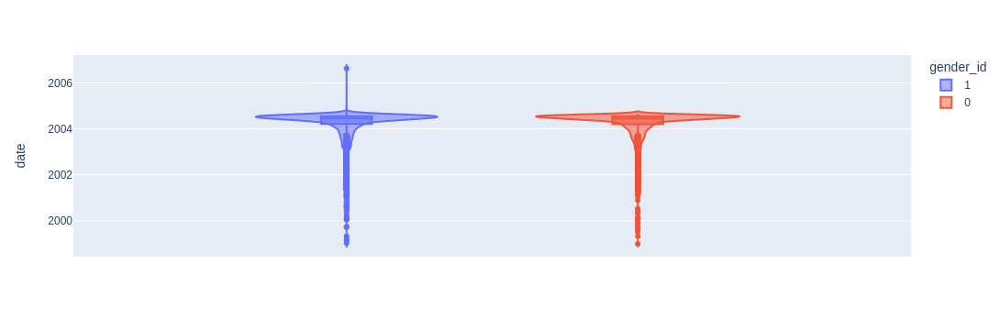

In [68]:
fig = px.violin(lkdf, y="date", color="gender_id", box=True, points="suspectedoutliers")
fig.show()

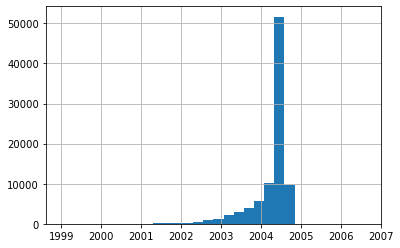

In [69]:
lkdf.date.hist(bins=30);

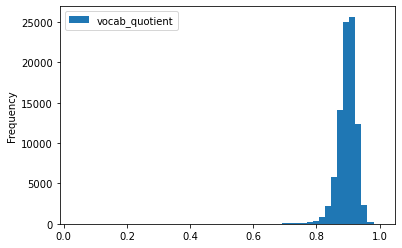

In [70]:
lkdf.plot("age", "vocab_quotient", kind="hist", bins=50);

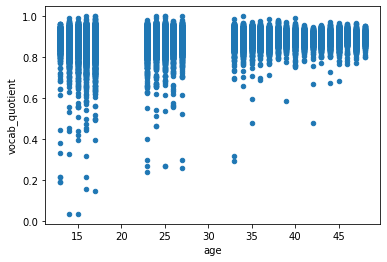

In [71]:
lkdf.plot("age", "vocab_quotient", kind="scatter");

In [72]:
medians = [median(lkdf[lkdf["age"]==a].vocab_quotient.values) for a in ages]
dists = [lkdf[lkdf["age"]==a].vocab_quotient.values for a in ages]

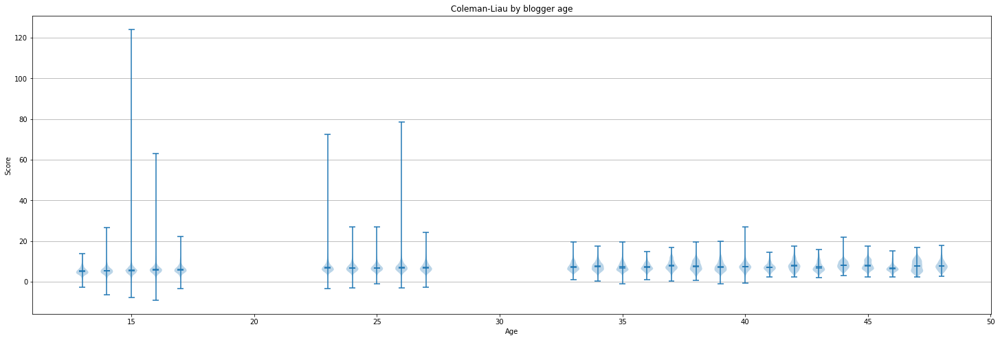

In [73]:
dists = [lkdf[lkdf["age"]==a].coleman_liau.values for a in ages]
fig, axs = plt.subplots(nrows=1, ncols=1, figsize=(25, 8))
axs.violinplot(dists, positions=ages, showmeans=True, showmedians=True)
axs.set_title('Coleman-Liau by blogger age')
axs.yaxis.grid(True)
axs.set_xlabel('Age')
axs.set_ylabel('Score')
plt.show()

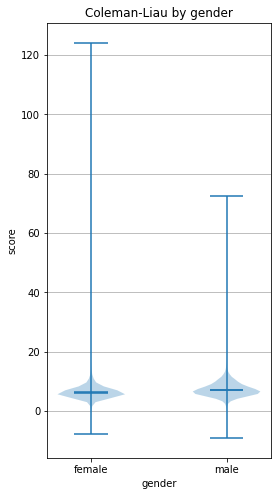

[6.253083405148483, 7.188147986705799]


In [74]:
genders = ["female", "male"]
gdists = [lkdf[lkdf["gender_id"]==0]["coleman_liau"].values, lkdf[lkdf["gender_id"]==1]["coleman_liau"].values]
fig, axs = plt.subplots(nrows=1, ncols=1, figsize=(4, 8))
axs.violinplot(gdists, positions=[0,1], showmeans=True, showmedians=True)
axs.set_title('Coleman-Liau by gender')
axs.yaxis.grid(True)
axs.set_xlabel('gender')
axs.set_xticks([0,1])
axs.set_xticklabels(genders)
axs.set_ylabel('score')
plt.show()
print([mean(d) for d in gdists])

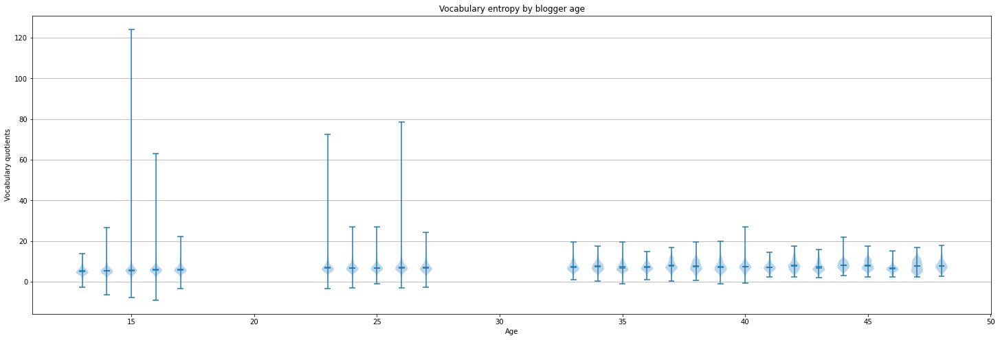

In [75]:
fig, axs = plt.subplots(nrows=1, ncols=1, figsize=(25, 8))
axs.violinplot(dists, positions=ages, showmeans=True, showmedians=True)
axs.set_title('Vocabulary entropy by blogger age')
axs.yaxis.grid(True)
axs.set_xlabel('Age')
axs.set_ylabel('Vocabulary quotients')
#axs.legend()
plt.show()

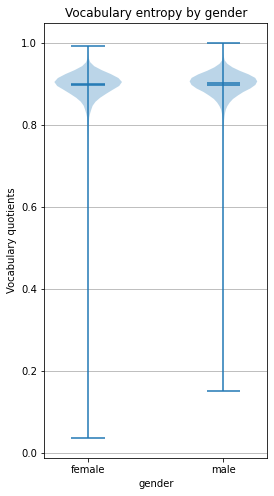

In [76]:
genders = ["female", "male"]
gdists = [lkdf[lkdf["gender_id"]==0].vocab_quotient.values, lkdf[lkdf["gender_id"]==1].vocab_quotient.values]
fig, axs = plt.subplots(nrows=1, ncols=1, figsize=(4, 8))
axs.violinplot(gdists, positions=[0,1], showmeans=True, showmedians=True)
axs.set_title('Vocabulary entropy by gender')
axs.yaxis.grid(True)
axs.set_xlabel('gender')
axs.set_xticks([0,1])
axs.set_xticklabels(genders)
axs.set_ylabel('Vocabulary quotients')
plt.show()

### Review of the extrema
What do the extremely high scoring posts look like?

In [77]:
lkdf.loc[lkdf["vocab_quotient"].idxmax()].text

"                  Spam.  For some reason.    urlLink Allen Hutchison  noticed  urlLink a post  a while back and thought you'd all like to visit his  urlLink Spamku generator .  You'll laugh, you'll cry, you'll love it more then Cats.    I shouldn't open spam I know.  But this one found it's way into my inbox instead of my 'bulk' folder.  Upon opening the attachmentless email, I found the following block of text in 0.0001 point font, underneath the sales pitch.  I think it's an anti-anti-spam feature designed to up the 'size' of the email from 1kb to say...9kb, but that's just a guess.    I have a feeling that graphic designers have a term for this block of random text.  It looks like schizophrenic ranting to me...  Especially the 'emmanuel guttural sabotage' part.  For what it's worth, here it is:  offertory reticulate bacterial dublin scope medic incompatible frigga grandchild crumple bidiagonal chore contribute richmond highroad countryside canine enoch camino hough insinuate babyho

In [78]:
lkdf.loc[lkdf["vocab_quotient"].idxmin()].text

'       bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bored bo

Well, that makes sense. The highest vocabulary entropy result is a set of random draws from the dictionary, the lowest scoring result is just a single word repeated constantly.

In [79]:
lkdf.loc[lkdf["flesch"].idxmax()].text

"       --------------------------------------------------------------------------------  CD: Robert Plant & Jimmy Page, 'No Quarter'  Umm....The idea for this post was that I would go to www.aljazeera.net, get an article in Arabic, and post it here for people to look at and go 'wUH?' It worked in Microsoft Word, and I was hopeful. The spellchecker even pointed out a couple errors, which I thought was interesting. It even posted well, but after pressing enter it came out all goofy-like. Well here you go anyway...note the number '1441' which kind of points out what it was talking about.  Ïæ ÝíáÈÇä íÐßÑ Ãä ÇáÞÑÇÑ 1441 íäÕ Úáì ÇÓÊãÑÇÑ ÚãáíÇÊ ÇáÊÝÊíÔ ÍÊì ÇáæÕæá Åáì Íá Ãæ ØÑíÞ ãÓÏæÏ ÜÜÜÜÜÜÜÜÜÜÜÜÜÜÜÜÜÜÜÜ æÒÑÇÁ ÈÑíØÇäíæä íÄßÏæä ËÞÉ ÈáíÑ Ýí ÇáÍÕæá Úáì ÇáÃßËÑíÉ ÈãÌáÓ ÇáÃãä áÏÚã ÇáÞÑÇÑ ÇáËÇäí æíåÏÏæä ÈÃä Ãæáì ÚãáíÇÊ ÇáÞÕÝ ÓÊáí ÇáÊÕæíÊ ãÈÇÔÑÉ ÜÜÜÜÜÜÜÜÜÜÜÜÜÜÜÜÜÜÜÜ ÇÓÊÆäÇÝ ÊÏãíÑ ÕæÇÑíÎ ÇáÕãæÏ/2 Ýí ãäØÞÉ ÇáÊÇÌí ÔãÇáí ÈÛÏÇÏ ÊÍÊ ÅÔÑÇÝ ÇáÃãã ÇáãÊÍÏÉ ÜÜÜÜÜÜÜÜÜÜÜÜÜÜÜÜÜÜÜÜ ÃßÏ æÒíÑ ÇáÎÇÑÌíÉ ÇáÝÑäÓí Ïæãíäí

In [80]:
lkdf.loc[lkdf["flesch"].idxmin()].text

'                                        BLUE  M  A  N  B  L  U  E  M  A  N  B  L  U  E  M  A  N  B  L  U  E  M  A  N  B  L  U  E  M  A  N  B  L  U  E  M  A  N  B  L  U  E  M  A  N  B  L  U  E  M  A  NB  L  U  E  M  A  N  B  L  U  E  M  A  N  B  L  U  E  M  A  N  B  L  U  E  M  A  N  B  L  U  E  M  A  N  B  L  U  E  M  A  N  B  L  U  E  M  A  N  B  L  U  E  M  A  N  B  L  U  E  M  A  N  B  L  U  E  M  A  N  B  L  UE   MANB  L  U  E  M  A  N  B  L  U  E  M  A  N  BL  U  E  M  A  N  B  L  U  E  M  A  N  B  L  U  E  M  A  N  B  L  U  E  M  A  N  B  L  U  E  M  A  N  B  L  U  E  M  A  N  B  L  U  E  M  A  N  B  L  U  E  M  A  N  B  L  U  E  M  A  N  B  L  U  E  M  A  N  B  L  U  E  M  A  N  B  L  U  E  M  A  N  B  L  U  E  M  A  N  B  L  U  E  M  A  N  B  L  U  E  M  A  N  B  L  U  E  M  A  NB   LUEM  A  N  B  L  U  E  M  A  N  B  L  U  E  M  A  N  B  L  U  E  M  AN  B  L  U  E  M  A  N  B  L  U  E  M  A  N  B  L  U  E  M  A  N  B  L  U  E  M  A  N  B  L  U  E  M  A  N  B  L  U  E  M  A  N

The Flesch-type scores are maxed in the case where someone made a bilingual post that was garbled, and minimized when a young person space separated every single letter.

In [81]:
lkdf.loc[lkdf["flesch"].idxmin()]

id                      1609589
gender                     male
age                          16
topic                   Student
sign                  Capricorn
                        ...    
topic_indUnk                  0
num_urls                      0
urls_per_word               0.0
letters_per_word       1.129268
sentences_per_word     0.000195
Name: 369167, Length: 71, dtype: object

In [82]:
lkdf.loc[lkdf["flesch-kincaid"].idxmax()]

id                      1609589
gender                     male
age                          16
topic                   Student
sign                  Capricorn
                        ...    
topic_indUnk                  0
num_urls                      0
urls_per_word               0.0
letters_per_word       1.129268
sentences_per_word     0.000195
Name: 369167, Length: 71, dtype: object

In [83]:
lkdf.loc[lkdf["flesch-kincaid"].idxmin()].text

"       How to play: Italics the ones you've seen. Link via  urlLink Rachel .  1. Titanic (1997) $600,779,824 * 2.  Star Wars (1977) $460,935,665  3.  E.T. the Extra-Terrestrial (1982) $434,949,459  * 4.  Star Wars: Episode I - The Phantom Menace (1999) $431,065,444  5.  Spider-Man (2002) $403,706,375  6. Lord of the Rings: The Return of the King, The (2003) $377,019,252 7. Passion of the Christ, The (2004) $370,025,697 8.  Jurassic Park (1993) $356,784,000  9. Shrek 2 (2004) $356,211,000 10.  Lord of the Rings: The Two Towers, The (2002) $340,478,898  11.  Finding Nemo (2003) $339,714,367  12.  Forrest Gump (1994) $329,691,196  13.  Lion King, The (1994) $328,423,001  14. Harry Potter and the Sorcerer's Stone (2001) $317,557,891 15.  Lord of the Rings: The Fellowship of the Ring, The (2001) $313,837,577  16. Star Wars: Episode II - Attack of the Clones (2002) $310,675,583 17.  Star Wars: Episode VI - Return of the Jedi (1983) $309,125,409  18.  Independence Day (1996) $306,124,059  19

Another way to reach strangely low scores is to use numbers heavily.

In [84]:
lkdf.loc[lkdf["coleman_liau"].idxmax()]

id                      3364110
gender                   female
age                          15
topic                    indUnk
sign                     Taurus
                        ...    
topic_indUnk                  1
num_urls                    128
urls_per_word          0.319202
letters_per_word      23.932668
sentences_per_word     0.024938
Name: 214733, Length: 71, dtype: object

In [85]:
lkdf.loc[lkdf["coleman_liau"].idxmax()].text[:200]

"       I've decided I'm gonna go round all the online clothes/shoes stores and make a list online of all the stuff I want.   urlLink http://www.alternative-footwear.co.uk/en-gb/p_501.html   urlLink ht"

Coleman-Liau got maxed by a post with 128 URL links, which boosted average word complexity ridiculously high.

### Stylometry: How much do readability scores and features vary within blog posts from the same author or demography?
If an indicator of authorship is consistent (low variance) in multiple samples by the same author, and high variance in samples from different authors, it has greater potential to distinguish between authors (when used independently from any other feature). Let's state that more formally. Let $\mathbb{A}=(A_1, A_2, ..., A_n)$ be a set of authors. Each author $A\in\mathbb{A}$ has a corpus of documents $\mathbb{D}_A=(D_{A,1}, D_{A,2}, ..., D_{A,N_A})$ that they have written. Let $Y_D=f(D)$ be a function value, where $f$ is some function on the features of a document $D$. We write the average function value for an author $A$ as

$$
\bar{Y}_A = \frac{1}{N_A}\sum_{i=1}^{N_A} f(D_{A,i})
$$

and the standard deviation (standard error) of an author's function values is $S_A$. The standard deviation for the set of each author's mean score is

$$
S_{\mathbb{A}} = std(\hat{Y}_A).
$$

We can now define the distinguishing potential of that function in the context of a given author and set of authors as 

$$
D(f\rvert A, \mathbb{A}) = \frac{S_\mathbb{A}}{S_A},
$$

the ratio of the group's standard deviation to the individual author's standard deviation. (Alternatively you could define the numerator to be the standard deviation of the group's mean scores, but this seems unnecessary.) The higher this value is, the more useful the function $f$ is in our effort to distinguish something written by author $A$ from the other authors. The maximum $\text{max}_{A\in\mathbb{A}} (D(f\rvert A, \mathbb{A}))$ gives us a sense of the worst that the function can perform as a discriminator between the two authors in this group. A good idea of the overall attribution power of the score is given by computing the observed probability that $\frac{S_\mathbb{A}}{S_A}>1$.

It is critical that each author's document set $\mathbb{D}_A$ is diverse and large enough. A sample of size $k=1$ would force $S_A\to 0$, as would a sample of duplicates. This is why we needed to check for duplicates before.

In [108]:
func_feat = list(set(score_functions+features)) # distinct functions and features

In [109]:
print(f"Each author is responsible for an average of {lkdf.shape[0]/lkdf['id'].unique().shape[0]} posts")

Each author is responsible for an average of 7.120438826615788 posts


Let's restrict our consideration to authors who have written $k=5$ or more posts.

In [110]:
k = 5 # The minimum number of posts required to consider an author.
v = lkdf.id.value_counts()
prolifics = lkdf[lkdf.id.isin(v.index[v.gt(k)])]
stds = {score: prolifics[score].values.std() for score in func_feat}

In [111]:
authors_stds = prolifics[["id", "age", "gender_id"]+func_feat].groupby(["id", "age", "gender_id"]).std().reset_index()
authors_means = prolifics[["id", "age", "gender_id"]+func_feat].groupby(["id", "age", "gender_id"]).mean().reset_index()
std_of_means = {score: authors_means[score].values.std() for score in func_feat}
authors_distinguishing_value = authors_stds.copy(deep=True)
for score in func_feat:
    authors_distinguishing_value[score] = stds[score]/authors_distinguishing_value[score]
    #authors_distinguishing_value[score] = authors_distinguishing_value[score]/std_of_means[score]
a_mins = [authors_distinguishing_value[score].values.min() for score in func_feat]
a_maxes = [authors_distinguishing_value[score].values.max() for score in func_feat]
a_medians = [median(authors_distinguishing_value[score].values) for score in func_feat]
a_means = [mean(authors_distinguishing_value[score].values) for score in func_feat]
num_rows = authors_distinguishing_value.shape[0]
a_above_1 = [authors_distinguishing_value[authors_distinguishing_value[score]>1][score].shape[0]/num_rows for score in func_feat]

In [112]:
# If you'd rather not use dataframes, here's an old-fashioned printing alternative
# print(f"{'score functions or features':<34} {'min value':<22} {'max value':<22} {'median value':<22} {'mean value':<22} {'P(score<1)':<22}")
# for i in range(len(func_feat)):
#     print(f"{func_feat[i]:<34} {a_mins[i]:<22} {a_maxes[i]:<22} {a_medians[i]:<22} {a_means[i]:<22} {a_below_1[i]:<22}")

In [113]:
# make a dataframe out of the above results
dfd = pd.DataFrame()
dfd["features"] = func_feat
dfd["min_value"] = a_mins
dfd["max_value"] = a_maxes
dfd["median_value"] = a_medians
dfd["mean_value"] = a_means
dfd["P(score>1)"] = a_above_1

In [114]:
#dfd.sort_values(by=["P(score<1)"])
dfd.sort_values(by=["P(score>1)"])

,features,min_value,max_value,median_value,mean_value,P(score>1)
12,vocab_quotient,0.106318,6.111516,1.371839,1.425317,0.826655
4,sentences_per_word,0.268538,19.134576,1.634465,1.932050,0.832623
2,dale_chall_dificult_words_per_word,0.244841,14.802778,1.810795,1.962263,0.877806
13,spache_complex_per_word,0.270524,13.915707,1.784539,1.922555,0.884058
19,gunning_complex_per_word,0.238958,92.076404,1.785545,1.998868,0.897414
0,poly_syllable_per_word,0.311314,12.905287,1.907432,2.112611,0.905655
6,coleman_liau,0.099901,15.931532,1.817327,2.030548,0.909349
3,linsear_write,0.057353,84.755647,8.005587,9.508247,0.912759
10,ari,0.052217,88.793872,8.397257,9.574266,0.915601
7,words_per_sentence,0.052082,92.360035,9.968940,11.457661,0.915601


So Flesch-Kincaid score really is the most distinguishing score for this corpus in terms of probability that the distinguishing power for an author is below 1. The ARI has lower mean, median, min, and max, however. 

In [117]:
cl_scores = ["coleman_liau", "letters_per_word", "words_per_sentence"]
cl_names = ["Coleman-Liau", "Letters per word", "Words per sentence"]
cl_name_map = {cl_scores[i]: cl_names[i] for i in range(len(cl_names))}
fl_scores = ["flesch", "syllables_per_word", "words_per_sentence"]
fl_names = ["Flesch score", "Syllables per word", "Words per sentence"]
fl_name_map = {fl_scores[i]: fl_names[i] for i in range(len(fl_names))}

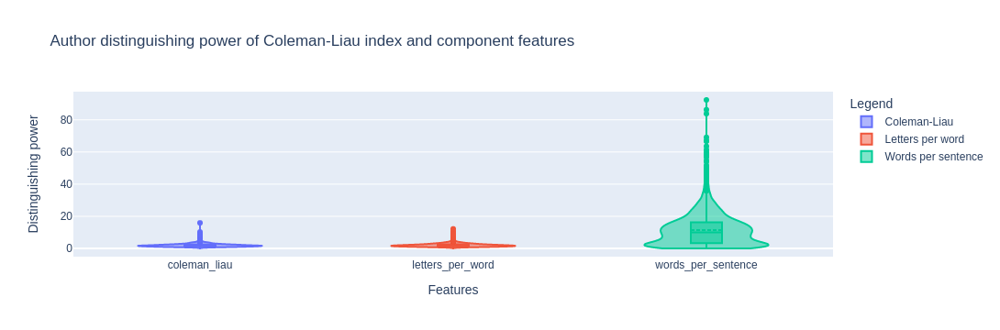

In [118]:
fig = go.Figure()
for score in cl_scores:
    fig.add_trace(go.Violin(x0=score,
                            y=authors_distinguishing_value[score],
                            name=cl_name_map[score],
                            box_visible=True,
                            meanline_visible=True,
                            spanmode="hard",
                           ))
fig.update_layout(
    title="Author distinguishing power of Coleman-Liau index and component features",
    xaxis_title="Features",
    yaxis_title="Distinguishing power",
    legend_title="Legend",
)

#fig.update_yaxes(type="log")

fig.write_image(file="fig_4_distinguishing.jpg", format='jpg')
fig.show()

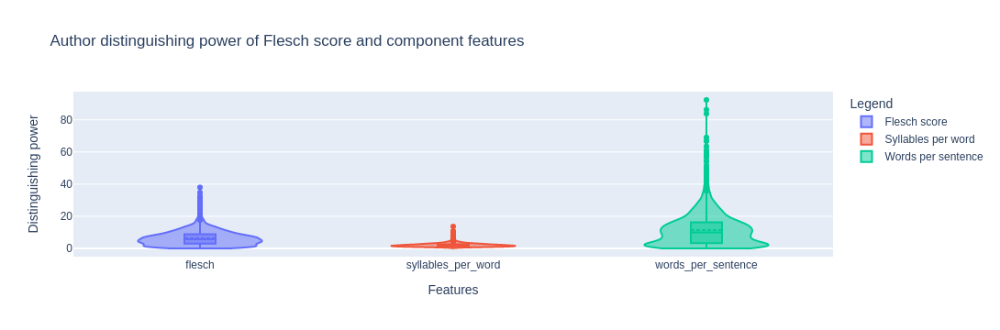

In [119]:
fig = go.Figure()
for score in fl_scores:
    fig.add_trace(go.Violin(x0=score,
                            y=authors_distinguishing_value[score],
                            name=fl_name_map[score],
                            box_visible=True,
                            meanline_visible=True,
                            spanmode="hard",
                           ))
fig.update_layout(
    title="Author distinguishing power of Flesch score and component features",
    xaxis_title="Features",
    yaxis_title="Distinguishing power",
    legend_title="Legend",
)

#fig.update_yaxes(type="log")

fig.write_image(file="fig_5_distinguishing.jpg", format='jpg')
fig.show()

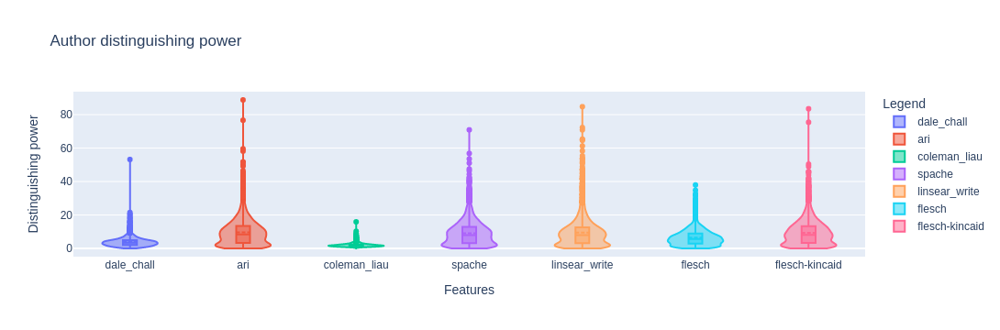

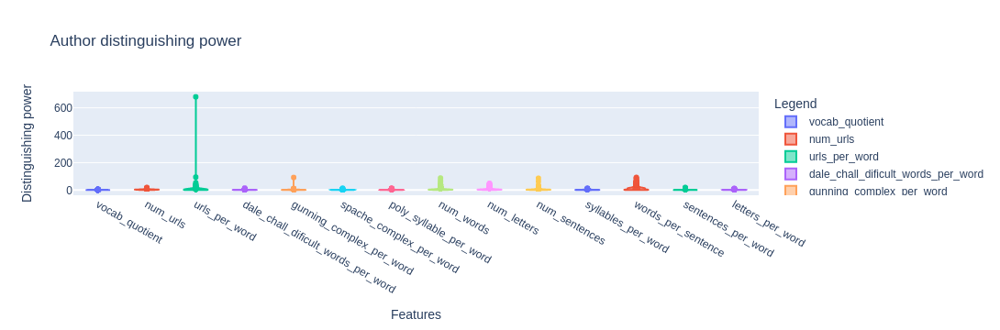

In [120]:
fig = go.Figure()
for score in score_functions[1:]:
    # print(authors_distinguishing_value[score].values.mean())
    fig.add_trace(go.Violin(x0=score,
                            y=authors_distinguishing_value[score],
                            name=score,
                            box_visible=True,
                            meanline_visible=True,
                            spanmode='hard',                            
                           ))
fig.update_layout(
    title="Author distinguishing power",
    xaxis_title="Features",
    yaxis_title="Distinguishing power",
    legend_title="Legend",
)
fig.show()
fig = go.Figure()
for score in features:
    fig.add_trace(go.Violin(
                            x0=score,
                            y=authors_distinguishing_value[score],
                            name=score,
                            box_visible=True,
                            meanline_visible=True,
                            spanmode='hard',
    ))
fig.update_layout(
    title="Author distinguishing power",
    xaxis_title="Features",
    yaxis_title="Distinguishing power",
    legend_title="Legend",
)
fig.show()

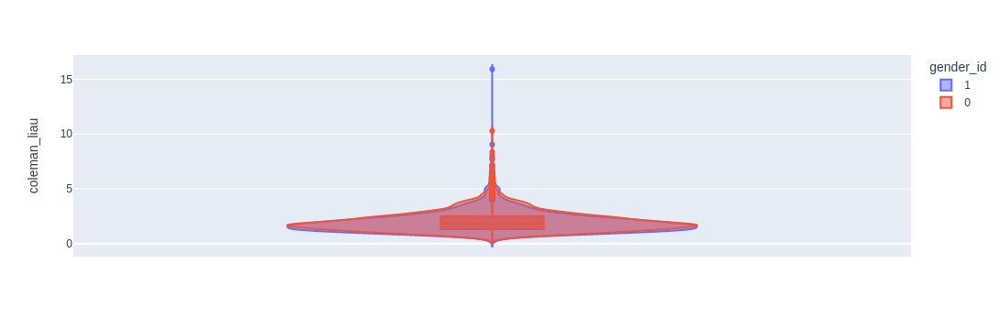

In [121]:
fig = px.violin(authors_distinguishing_value, y="coleman_liau", color="gender_id", box=True, violinmode='overlay')
fig.show()

In [122]:
print_gender_stats("vocab_quotient", authors_stds)

vocab_quotient by gender
         male                 female              
mean     0.025463179590224733 0.026670675209279147
std      0.013749332252755085 0.016908639070204907
median   0.02268812606348814  0.02311671964575236 


We'll now repeat the work above, but this time we check the power of each feature or score to distinguish sex.

In [156]:
authors_stds = prolifics[["gender_id"]+func_feat].groupby(["gender_id"]).std().reset_index()
authors_means = prolifics[["gender_id"]+func_feat].groupby(["gender_id"]).mean().reset_index()
std_of_means = {score: authors_means[score].values.std() for score in func_feat}
sex_distinguishing_value = authors_stds.copy(deep=True)
for score in func_feat:
    sex_distinguishing_value[score] = stds[score]/sex_distinguishing_value[score]
    #authors_distinguishing_value[score] = authors_distinguishing_value[score]/std_of_means[score]
a_mins = [sex_distinguishing_value[score].values.min() for score in func_feat]
a_maxes = [sex_distinguishing_value[score].values.max() for score in func_feat]
a_medians = [median(sex_distinguishing_value[score].values) for score in func_feat]
a_means = [mean(sex_distinguishing_value[score].values) for score in func_feat]
num_rows = sex_distinguishing_value.shape[0]
a_below_1 = [sex_distinguishing_value[sex_distinguishing_value[score]>1][score].shape[0]/num_rows for score in func_feat]

# make a dataframe out of the above results
dfd = pd.DataFrame()
dfd["features"] = func_feat
dfd["min_value"] = a_mins
dfd["max_value"] = a_maxes
dfd["median_value"] = a_medians
dfd["mean_value"] = a_means
dfd["P(score>1)"] = a_below_1

dfd.sort_values(by=["mean_value"])

,features,min_value,max_value,median_value,mean_value,P(score>1)
7,words_per_sentence,0.998896,1.001018,0.999957,0.999957,0.5
20,flesch-kincaid,0.997487,1.002438,0.999963,0.999963,0.5
10,ari,0.997832,1.002102,0.999967,0.999967,0.5
3,linsear_write,0.999652,1.000322,0.999987,0.999987,0.5
17,spache,0.999711,1.000398,1.000054,1.000054,0.5
15,num_sentences,0.996779,1.003484,1.000132,1.000132,0.5
16,flesch,0.993502,1.007300,1.000401,1.000401,0.5
9,dale_chall,0.998514,1.002829,1.000672,1.000672,0.5
12,vocab_quotient,0.973618,1.032285,1.002952,1.002952,0.5
2,dale_chall_dificult_words_per_word,0.996931,1.012437,1.004684,1.004684,0.5


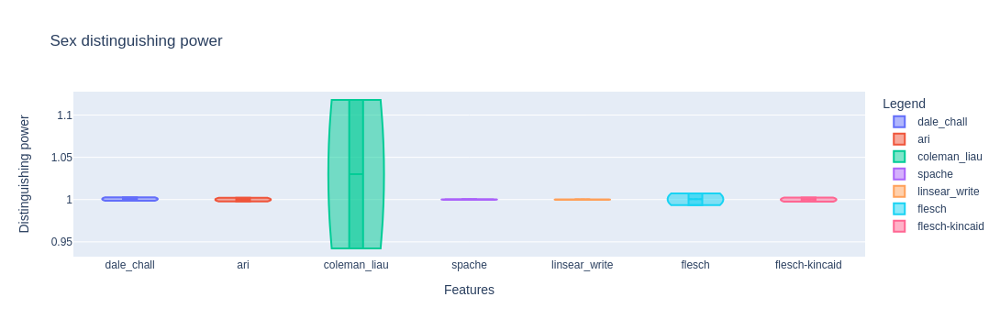

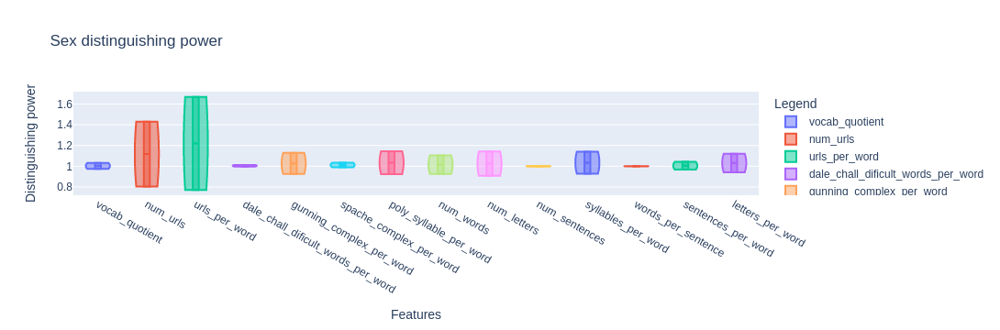

In [158]:
fig = go.Figure()
for score in score_functions[1:]:
    # print(authors_distinguishing_value[score].values.mean())
    fig.add_trace(go.Violin(x0=score,
                            y=sex_distinguishing_value[score],
                            name=score,
                            box_visible=True,
                            meanline_visible=True,
                            spanmode='hard',                            
                           ))
fig.update_layout(
    title="Sex distinguishing power",
    xaxis_title="Features",
    yaxis_title="Distinguishing power",
    legend_title="Legend",
)


fig.show()
fig = go.Figure()
for score in features:
    fig.add_trace(go.Violin(
                            x0=score,
                            y=sex_distinguishing_value[score],
                            name=score,
                            box_visible=True,
                            meanline_visible=True,
                            spanmode='hard',
    ))
fig.update_layout(
    title="Sex distinguishing power",
    xaxis_title="Features",
    yaxis_title="Distinguishing power",
    legend_title="Legend",
)


fig.show()

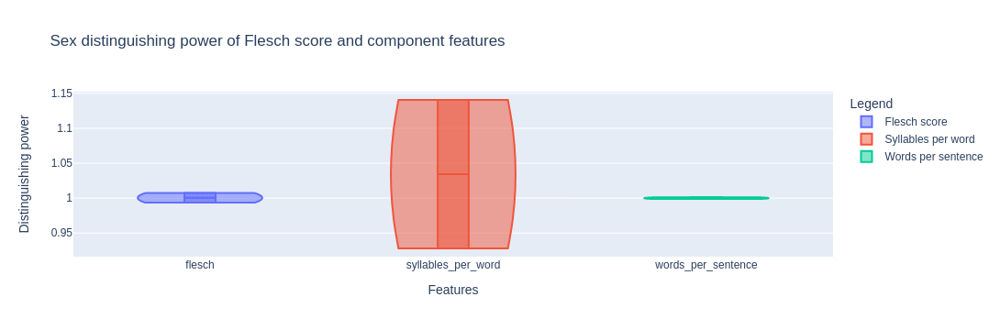

In [159]:
fig = go.Figure()
for score in fl_scores:
    fig.add_trace(go.Violin(x0=score,
                            y=sex_distinguishing_value[score],
                            name=fl_name_map[score],
                            box_visible=True,
                            meanline_visible=True,
                            spanmode="hard",
                           ))
fig.update_layout(
    title="Sex distinguishing power of Flesch score and component features",
    xaxis_title="Features",
    yaxis_title="Distinguishing power",
    legend_title="Legend",
)

#fig.update_yaxes(type="log")

fig.write_image(file="fig_5_distinguishing.jpg", format='jpg')
fig.show()

And now we check the power to distinguish age and sex groups (e.g. males age 16).

In [144]:
authors_stds = prolifics[["age", "gender_id"]+func_feat].groupby(["age", "gender_id"]).std().reset_index()
authors_means = prolifics[["age", "gender_id"]+func_feat].groupby(["age", "gender_id"]).mean().reset_index()
std_of_means = {score: authors_means[score].values.std() for score in func_feat}
authors_distinguishing_value = authors_stds.copy(deep=True)
for score in func_feat:
    authors_distinguishing_value[score] = stds[score]/authors_distinguishing_value[score]
    #authors_distinguishing_value[score] = authors_distinguishing_value[score]/std_of_means[score]
a_mins = [authors_distinguishing_value[score].values.min() for score in func_feat]
a_maxes = [authors_distinguishing_value[score].values.max() for score in func_feat]
a_medians = [median(authors_distinguishing_value[score].values) for score in func_feat]
a_means = [mean(authors_distinguishing_value[score].values) for score in func_feat]
num_rows = authors_distinguishing_value.shape[0]
a_below_1 = [authors_distinguishing_value[authors_distinguishing_value[score]>1][score].shape[0]/num_rows for score in func_feat]
# make a dataframe out of the above results
dfd = pd.DataFrame()
dfd["features"] = func_feat
dfd["min_value"] = a_mins
dfd["max_value"] = a_maxes
dfd["median_value"] = a_medians
dfd["mean_value"] = a_means
dfd["P(score>1)"] = a_below_1
dfd.sort_values(by=["P(score>1)"])

,features,min_value,max_value,median_value,mean_value,P(score>1)
0,poly_syllable_per_word,0.629814,1.584242,1.053313,1.064393,0.576923
5,syllables_per_word,0.598474,1.489233,1.067027,1.075574,0.596154
13,spache_complex_per_word,0.640095,1.667614,1.048306,1.075749,0.596154
6,coleman_liau,0.680665,1.577944,1.088743,1.080514,0.634615
11,letters_per_word,0.626665,1.471972,1.079793,1.090085,0.634615
2,dale_chall_dificult_words_per_word,0.586815,1.897077,1.119100,1.119285,0.653846
19,gunning_complex_per_word,0.609809,1.495397,1.061524,1.061686,0.673077
4,sentences_per_word,0.676121,2.409346,1.178083,1.215695,0.730769
12,vocab_quotient,0.718817,1.454822,1.136774,1.100304,0.750000
17,spache,0.309691,6.583902,1.895893,2.443522,0.807692


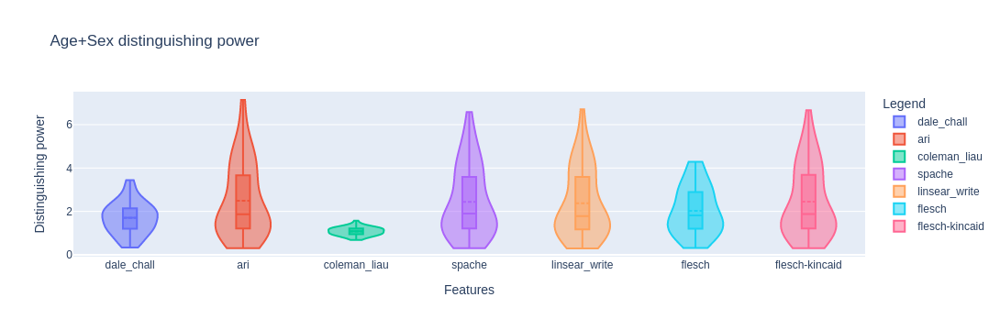

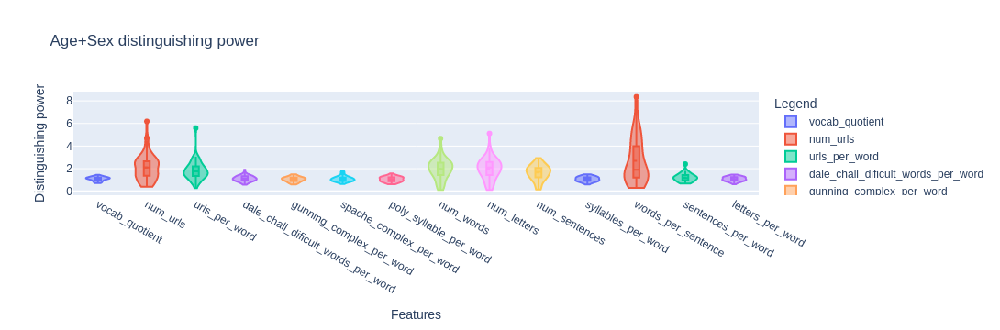

In [145]:
fig = go.Figure()
for score in score_functions[1:]:
    # print(authors_distinguishing_value[score].values.mean())
    fig.add_trace(go.Violin(x0=score,
                            y=authors_distinguishing_value[score],
                            name=score,
                            box_visible=True,
                            meanline_visible=True,
                            spanmode='hard',                            
                           ))
fig.update_layout(
    title="Age+Sex distinguishing power",
    xaxis_title="Features",
    yaxis_title="Distinguishing power",
    legend_title="Legend",
)
fig.show()
fig = go.Figure()
for score in features:
    fig.add_trace(go.Violin(
                            x0=score,
                            y=authors_distinguishing_value[score],
                            name=score,
                            box_visible=True,
                            meanline_visible=True,
                            spanmode='hard',
    ))
fig.update_layout(
    title="Age+Sex distinguishing power",
    xaxis_title="Features",
    yaxis_title="Distinguishing power",
    legend_title="Legend",
)
fig.show()

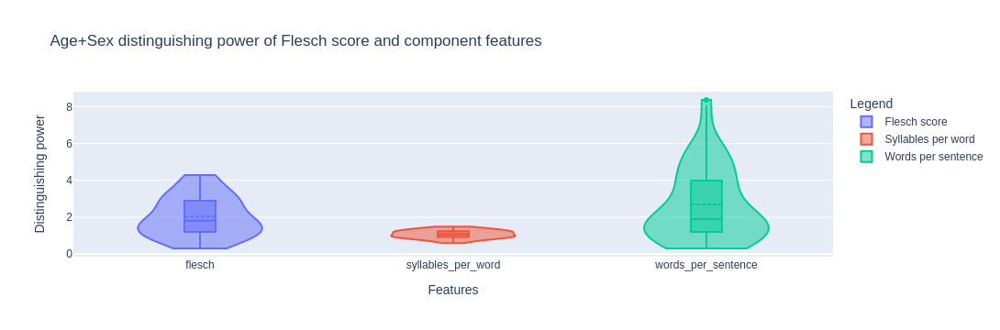

In [147]:
fig = go.Figure()
for score in fl_scores:
    fig.add_trace(go.Violin(x0=score,
                            y=authors_distinguishing_value[score],
                            name=fl_name_map[score],
                            box_visible=True,
                            meanline_visible=True,
                            spanmode="hard",
                           ))
fig.update_layout(
    title="Age+Sex distinguishing power of Flesch score and component features",
    xaxis_title="Features",
    yaxis_title="Distinguishing power",
    legend_title="Legend",
)

#fig.update_yaxes(type="log")

fig.write_image(file="fig_5_distinguishing.jpg", format='jpg')
fig.show()

Now we'll check distinguishing power for age alone.

In [160]:
authors_stds = prolifics[["age"]+func_feat].groupby(["age"]).std().reset_index()
authors_means = prolifics[["age"]+func_feat].groupby(["age"]).mean().reset_index()
std_of_means = {score: authors_means[score].values.std() for score in func_feat}
age_distinguishing_value = authors_stds.copy(deep=True)
for score in func_feat:
    age_distinguishing_value[score] = stds[score]/age_distinguishing_value[score]
    #authors_distinguishing_value[score] = authors_distinguishing_value[score]/std_of_means[score]
a_mins = [age_distinguishing_value[score].values.min() for score in func_feat]
a_maxes = [age_distinguishing_value[score].values.max() for score in func_feat]
a_medians = [median(age_distinguishing_value[score].values) for score in func_feat]
a_means = [mean(age_distinguishing_value[score].values) for score in func_feat]
num_rows = age_distinguishing_value.shape[0]
a_below_1 = [age_distinguishing_value[age_distinguishing_value[score]>1][score].shape[0]/num_rows for score in func_feat]
# make a dataframe out of the above results
dfd = pd.DataFrame()
dfd["features"] = func_feat
dfd["min_value"] = a_mins
dfd["max_value"] = a_maxes
dfd["median_value"] = a_medians
dfd["mean_value"] = a_means
dfd["P(score>1)"] = a_below_1
dfd.sort_values(by=["P(score>1)"])

,features,min_value,max_value,median_value,mean_value,P(score>1)
13,spache_complex_per_word,0.741705,1.556323,0.984787,1.009287,0.461538
0,poly_syllable_per_word,0.696656,1.348940,1.002630,1.003750,0.500000
5,syllables_per_word,0.685879,1.379807,1.005993,1.008685,0.500000
19,gunning_complex_per_word,0.665062,1.422811,1.015227,1.009360,0.538462
11,letters_per_word,0.712866,1.401217,1.019453,1.024851,0.576923
6,coleman_liau,0.759708,1.405130,1.019283,1.019868,0.615385
2,dale_chall_dificult_words_per_word,0.637009,1.807887,1.043828,1.062984,0.653846
8,num_urls,0.562551,3.811530,1.566089,1.709916,0.692308
3,linsear_write,0.394854,4.672487,1.662498,1.982668,0.769231
9,dale_chall,0.458824,3.109254,1.616432,1.531449,0.769231


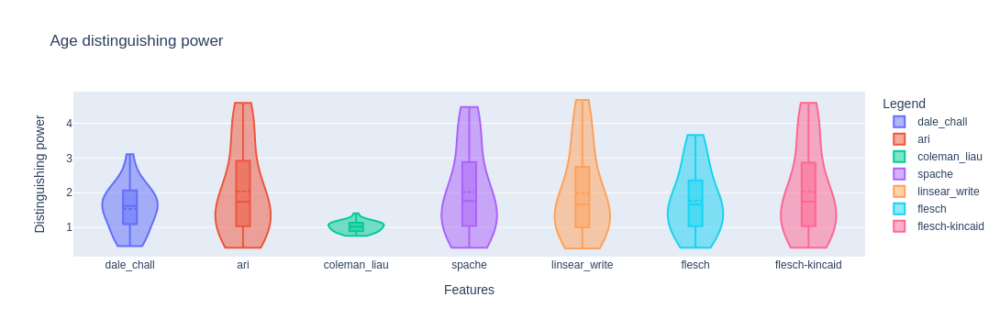

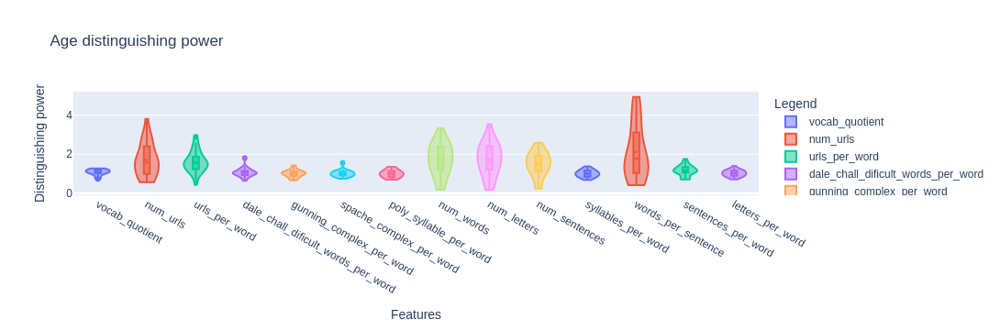

In [161]:
fig = go.Figure()
for score in score_functions[1:]:
    # print(authors_distinguishing_value[score].values.mean())
    fig.add_trace(go.Violin(x0=score,
                            y=age_distinguishing_value[score],
                            name=score,
                            box_visible=True,
                            meanline_visible=True,
                            spanmode='hard',                            
                           ))
fig.update_layout(
    title="Age distinguishing power",
    xaxis_title="Features",
    yaxis_title="Distinguishing power",
    legend_title="Legend",
)


fig.show()
fig = go.Figure()
for score in features:
    fig.add_trace(go.Violin(
                            x0=score,
                            y=age_distinguishing_value[score],
                            name=score,
                            box_visible=True,
                            meanline_visible=True,
                            spanmode='hard',
    ))
fig.update_layout(
    title="Age distinguishing power",
    xaxis_title="Features",
    yaxis_title="Distinguishing power",
    legend_title="Legend",
)


fig.show()

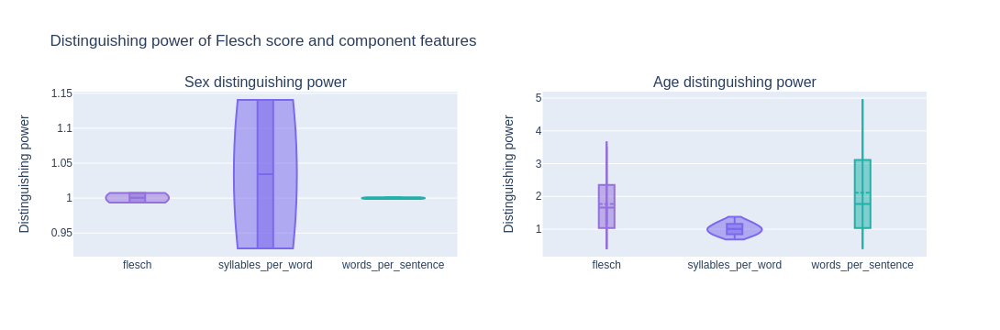

In [186]:
from plotly.subplots import make_subplots
score_colors = ["mediumpurple", "mediumslateblue", "lightseagreen"]
fig = make_subplots(rows=1, cols=2, start_cell="bottom-left", subplot_titles=["Sex distinguishing power", "Age distinguishing power"])
for score in fl_scores:
    
    fig.add_trace(go.Violin(x0=score,
                            y=sex_distinguishing_value[score],
                            line_color=score_colors[fl_scores.index(score)],
                            name=fl_name_map[score],
                            box_visible=True,
                            meanline_visible=True,
                            spanmode="hard",
                           ),
                 row=1,
                 col=1,
                 )

for score in fl_scores:
    fig.add_trace(go.Violin(x0=score,
                            y=age_distinguishing_value[score],
                            line_color=score_colors[fl_scores.index(score)],
                            name=fl_name_map[score],
                            box_visible=True,
                            meanline_visible=True,
                            spanmode="hard",
                           ),
                 row=1,
                 col=2,
                 )
fig.update_layout(
    coloraxis=dict(colorscale='Bluered_r'),
    title="Distinguishing power of Flesch score and component features",
    showlegend=False,
)
fig.update_yaxes(title_text="Distinguishing power", row=1, col=1)
fig.update_yaxes(title_text="Distinguishing power", row=1, col=2)

fig.write_image(file="fig_4_distinguishing.jpg", format='jpg')
fig.show()

# References
1. J. Schler, M. Koppel, S. Argamon and J. Pennebaker (2006). Effects of Age and Gender on Blogging in Proceedings of 2006 AAAI Spring Symposium on Computational Approaches for Analyzing Weblogs.